<a href="https://colab.research.google.com/github/Alejo3107/PROYECTO_CH_DS/blob/main/3%C2%BA_Entrega_Proyecto_Final_100.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**TERCERA ENTREGA DE PROYECTO FINAL**

**Conformación del equipo de trabajo**

Integrantes: Alejo Carballo, Agustina Clissa,  Agustina Mel

**Presentación de la empresa, organización o problema específico**

La base de datos elegida para realizar el proyecto final está compuesta por un set de personas aseguradas de una compañía internacional de seguros con sede en Argentina. Se cuenta con un total de 570.379 registros que corresponden a la contratación de un seguro para tres tipos de productos disponibles: Autos, Accidentes Personales y Vivienda.
Debido a la cantidad de registros, es imprescindible organizar y gestionar los datos  para hacer un estudio de predicción y, de esta forma,  poder tomar las mejores decisiones que aporten ventaja competitiva a mediano y largo plazo.

**Preguntas y objetivos de la investigación**

El objetivo de la investigación es poder predecir cuál es el mejor producto que le podemos ofrecer a un nuevo cliente. 
Realizar un cross selling de producto. Por ejemplo: a un cliente que adquirió el producto Autos qué otro producto le puedo ofrecer, dadas sus características.

**Indicación de la fuente del dataset y los criterios de selección - Data Acquisition**

Base de pólizas vigentes en el mes de junio-2022 de 3 productos diferentes que ofrece la compañía de seguros de la Argentina, en donde trabaja uno de los integrantes del equipo. Se han seleccionado esos productos ya que son los mas relevantes dentro de la compañia.
La base de datos se encuentra en hoja de cálculo de Microsoft Excel (.xlsx)
Generación del primer Data Wrangling y EDA, apuntado a sus datos (insights) univariado, bivariado y multivariado.


# **Descripción de Variables**
A continuación se describen la variables utilizadas en el DataSet
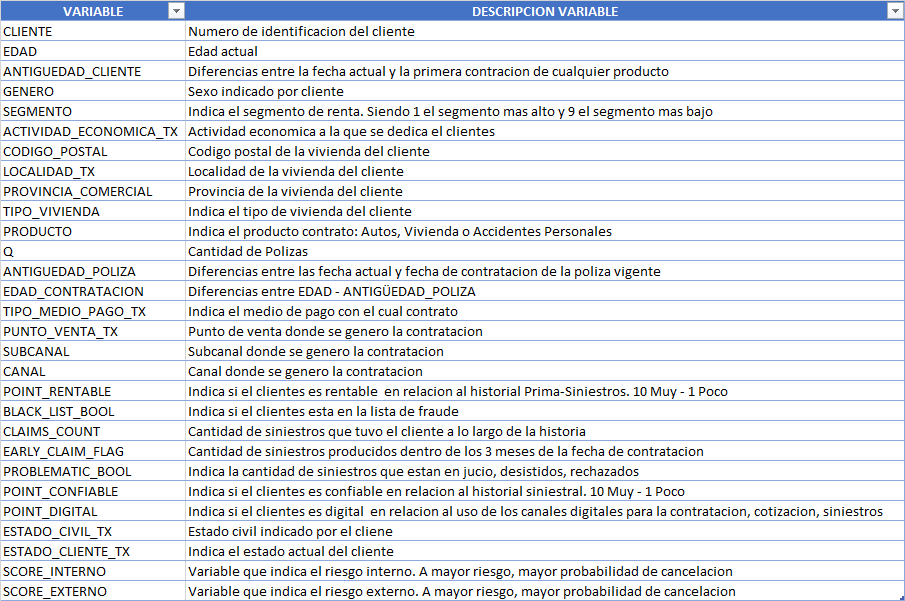

Importo Librerias

In [ ]:
import numpy as np
import pandas as pd
#!pip install pandas==1.2.0
#import pandas_profiling
#!pip install pandas-profiling

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
from seaborn import boxplot
from seaborn import distplot
import seaborn as sns

from sklearn import preprocessing
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage 
from sklearn.cluster import AgglomerativeClustering
from sklearn import metrics

from mpl_toolkits import mplot3d
import missingno as msno

import warnings
warnings.filterwarnings("ignore")

Leo DataSet desde Drive

In [ ]:
url = 'https://github.com/Alejo3107/PROYECTO_CH_DS/blob/d47d14fbef7294fb459d08bddc6ad2a8908d024d/Datasets/Vigentes_dataset_100.xlsx?raw=true' # reducir tamaño de muestra de manera aleatoria (quedarse con 50% o 25%)

df = pd.read_excel(url)

In [ ]:
print('Este data set tiene ' + str(df.shape[0]) + ' filas, y ' + str(df.shape[1]) + ' columnas')

Este data set tiene 570379 filas, y 28 columnas


In [ ]:
#Totalidad de registros por columnas
df.count()

CLIENTE_ID                570379
EDAD                      570379
ANTIGUEDAD_CLIENTE        570379
GENERO                    570379
SEGMENTO                  570379
ACTIVIDAD_ECONOMICA_TX    570379
CODIGO_POSTAL             570379
LOCALIDAD_TX              570379
PROVINCIA_COMERCIAL       570379
TIPO_VIVIENDA             570379
RAMO_PROP_TX              570379
Q                         570379
ANTIGUEDAD_POLIZA         570379
EDAD_CONTRATACION         570379
TIPO_MEDIO_PAGO_TX        570379
PUNTO_VENTA_TX            570379
SUBCANAL                  570379
CANAL                     570379
POINT_RENTABLE            570379
BLACK_LIST_BOOL           570379
CLAIMS_COUNT              570379
EARLY_CLAIM_FLAG          570379
PROBLEMATIC_BOOL          570379
POINT_CONFIABLE           570379
POINT_DIGITAL             570379
ESTADO_CIVIL_TX           570379
SCORE_INTERNO             570379
SCORE_EXTERNO             570379
dtype: int64

In [ ]:
df.columns

Index(['CLIENTE_ID', 'EDAD', 'ANTIGUEDAD_CLIENTE', 'GENERO', 'SEGMENTO',
       'ACTIVIDAD_ECONOMICA_TX', 'CODIGO_POSTAL', 'LOCALIDAD_TX',
       'PROVINCIA_COMERCIAL', 'TIPO_VIVIENDA', 'RAMO_PROP_TX', 'Q',
       'ANTIGUEDAD_POLIZA', 'EDAD_CONTRATACION', 'TIPO_MEDIO_PAGO_TX',
       'PUNTO_VENTA_TX', 'SUBCANAL', 'CANAL', 'POINT_RENTABLE',
       'BLACK_LIST_BOOL', 'CLAIMS_COUNT', 'EARLY_CLAIM_FLAG',
       'PROBLEMATIC_BOOL', 'POINT_CONFIABLE', 'POINT_DIGITAL',
       'ESTADO_CIVIL_TX', 'SCORE_INTERNO', 'SCORE_EXTERNO'],
      dtype='object')

In [ ]:
#Tipos de datos
df.dtypes

CLIENTE_ID                 int64
EDAD                       int64
ANTIGUEDAD_CLIENTE         int64
GENERO                    object
SEGMENTO                   int64
ACTIVIDAD_ECONOMICA_TX    object
CODIGO_POSTAL              int64
LOCALIDAD_TX              object
PROVINCIA_COMERCIAL       object
TIPO_VIVIENDA             object
RAMO_PROP_TX              object
Q                          int64
ANTIGUEDAD_POLIZA          int64
EDAD_CONTRATACION          int64
TIPO_MEDIO_PAGO_TX        object
PUNTO_VENTA_TX             int64
SUBCANAL                   int64
CANAL                      int64
POINT_RENTABLE             int64
BLACK_LIST_BOOL            int64
CLAIMS_COUNT               int64
EARLY_CLAIM_FLAG           int64
PROBLEMATIC_BOOL           int64
POINT_CONFIABLE            int64
POINT_DIGITAL              int64
ESTADO_CIVIL_TX           object
SCORE_INTERNO              int64
SCORE_EXTERNO              int64
dtype: object

In [ ]:
df.head()

,CLIENTE_ID,EDAD,ANTIGUEDAD_CLIENTE,GENERO,SEGMENTO,ACTIVIDAD_ECONOMICA_TX,CODIGO_POSTAL,LOCALIDAD_TX,PROVINCIA_COMERCIAL,TIPO_VIVIENDA,...,POINT_RENTABLE,BLACK_LIST_BOOL,CLAIMS_COUNT,EARLY_CLAIM_FLAG,PROBLEMATIC_BOOL,POINT_CONFIABLE,POINT_DIGITAL,ESTADO_CIVIL_TX,SCORE_INTERNO,SCORE_EXTERNO
0,188593,31,5,MASCULINO,2,551,2204,JESUS MA,SANTA FE,CASA,...,7,0,0,0,1,2,4,SOLTERO,6,8
1,361882,56,13,FEMENINO,3,139,1704,CAPITAL FEDERAL,BUENOS AIRES - GRAN BS AS,CASA,...,9,0,0,0,0,10,1,NO INFORMADO,13,15
2,113504,69,20,FEMENINO,2,433,1663,SAN MIGUEL,BUENOS AIRES - GRAN BS AS,CASA,...,10,0,3,0,0,4,1,SOLTERO,7,10
3,249641,72,2,MASCULINO,1,230,7632,NECOCHEA,BUENOS AIRES,CASA,...,6,0,0,0,0,6,4,SOLTERO,17,15
4,203110,55,21,FEMENINO,2,139,6304,SANTA ROSA,LA PAMPA,CASA,...,9,0,0,0,0,10,1,CASADO,0,0


#**Data Wrangling:**

a.- Revisión de la información disponible en la base de datos. Un total de 28 columnas con diversas características de cada uno de los registros.

b.- Identificación de datos nulos, registros en blanco o inconsistentes y posterior eliminación de estos para evitar que generen algún impacto no deseado en el proceso de toma de decisiones. No posee registros inconsistentes. 

Los datos nulos no son significativos.

c.- Limpieza y normalización de datos para lograr extraer información que genere valor y lograr así un análisis más exacto.


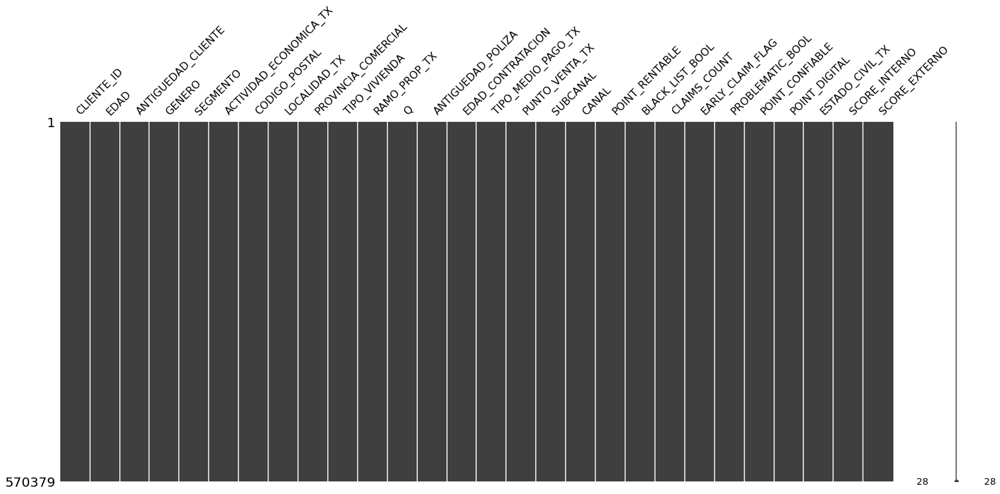

In [ ]:
msno.matrix(df)

# **Estadistica descriptiva del DataSet**

In [ ]:
df.describe().T.round(1)

,count,mean,std,min,25%,50%,75%,max
CLIENTE_ID,570379.0,227607.7,134248.5,1.0,110528.5,225944.0,342850.5,468364.0
EDAD,570379.0,48.1,13.9,16.0,38.0,47.0,58.0,112.0
ANTIGUEDAD_CLIENTE,570379.0,9.3,6.7,0.0,4.0,8.0,14.0,28.0
SEGMENTO,570379.0,2.5,1.3,1.0,1.0,2.0,3.0,9.0
CODIGO_POSTAL,570379.0,3313.6,2263.9,-2.0,1650.0,1980.0,5011.0,9420.0
Q,570379.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
ANTIGUEDAD_POLIZA,570379.0,5.0,5.4,0.0,1.0,3.0,8.0,23.0
EDAD_CONTRATACION,570379.0,43.1,13.3,5.0,33.0,42.0,52.0,110.0
PUNTO_VENTA_TX,570379.0,84.8,91.9,1.0,5.0,41.0,150.0,348.0
SUBCANAL,570379.0,3.7,5.1,1.0,1.0,1.0,3.0,22.0


#**Estadistica descriptiva del producto A - Autos**

La antigüedad promedio de los clientes que adquirieron este producto es de 8,9 años. 

La edad de contratación promedio es de 43 años y la edad actual promedio es de 48,7 años. 

El Score interno como externo promedio está en alrededor de 11.


In [ ]:
in_a = df['RAMO_PROP_TX'] =='AUTOS'
df_prod_a = df[in_a]
df_prod_a
df_prod_a.describe().T.round(1)

,count,mean,std,min,25%,50%,75%,max
CLIENTE_ID,213097.0,227356.5,133723.4,1.0,112031.0,224315.0,338199.0,468359.0
EDAD,213097.0,48.7,13.0,18.0,39.0,49.0,59.0,112.0
ANTIGUEDAD_CLIENTE,213097.0,8.9,6.4,0.0,4.0,8.0,14.0,28.0
SEGMENTO,213097.0,2.6,1.3,1.0,1.0,2.0,4.0,9.0
CODIGO_POSTAL,213097.0,3369.8,2260.5,-2.0,1663.0,2000.0,5017.0,9420.0
Q,213097.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
ANTIGUEDAD_POLIZA,213097.0,5.4,5.2,0.0,1.0,4.0,9.0,23.0
EDAD_CONTRATACION,213097.0,43.2,12.5,13.0,33.0,43.0,53.0,100.0
PUNTO_VENTA_TX,213097.0,81.3,93.1,1.0,5.0,41.0,142.0,348.0
SUBCANAL,213097.0,3.0,3.8,1.0,1.0,1.0,3.0,22.0


# **Estadistica descriptiva del producto B - Vivienda**
La antigüedad promedio de los clientes que adquirieron este producto es de 11,1 años. 

La edad de contratación promedio es de 50 años y la edad actual promedio es de 54,8 años. 

El Score interno promedio es de 12,6 puntos y el Score externo de 13,5.


In [ ]:
in_b = df['RAMO_PROP_TX'] =='VIVIENDA'
df_prod_b = df[in_b]
df_prod_b
df_prod_b.describe().T.round(1)

,count,mean,std,min,25%,50%,75%,max
CLIENTE_ID,174291.0,210697.6,127230.3,3.0,99803.5,202609.0,317112.5,468354.0
EDAD,174291.0,54.8,14.2,16.0,44.0,54.0,65.0,111.0
ANTIGUEDAD_CLIENTE,174291.0,11.1,7.1,0.0,5.0,11.0,17.0,28.0
SEGMENTO,174291.0,2.4,1.3,1.0,2.0,2.0,3.0,9.0
CODIGO_POSTAL,174291.0,3120.3,2264.0,-2.0,1611.0,1852.0,5001.0,9420.0
Q,174291.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
ANTIGUEDAD_POLIZA,174291.0,4.8,5.7,0.0,1.0,2.0,7.0,23.0
EDAD_CONTRATACION,174291.0,50.1,14.0,5.0,39.0,49.0,60.0,110.0
PUNTO_VENTA_TX,174291.0,83.6,90.2,1.0,5.0,41.0,155.0,347.0
SUBCANAL,174291.0,4.5,6.0,1.0,1.0,1.0,5.0,22.0


# **Estadistica descriptiva del producto C - Accidentes Personales**

La antigüedad promedio de los clientes que adquirieron este producto es de 8 años. 

La edad de contratación promedio es de 36,4 años y la edad actual promedio es de 41,1 años. 

El Score interno como externo promedio es de 10 puntos.


In [ ]:
in_c = df['RAMO_PROP_TX'] =='ACCIDENTES PERSONALES'
df_prod_c = df[in_c]
df_prod_c
df_prod_c.describe().T.round(1)

,count,mean,std,min,25%,50%,75%,max
CLIENTE_ID,182991.0,244006.3,139259.5,6.0,120852.5,250449.0,367324.5,468364.0
EDAD,182991.0,41.1,11.1,17.0,33.0,40.0,48.0,111.0
ANTIGUEDAD_CLIENTE,182991.0,8.1,6.3,0.0,2.0,7.0,13.0,28.0
SEGMENTO,182991.0,2.6,1.3,1.0,1.0,2.0,4.0,9.0
CODIGO_POSTAL,182991.0,3432.3,2256.0,-2.0,1686.0,2300.0,5012.0,9420.0
Q,182991.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
ANTIGUEDAD_POLIZA,182991.0,4.7,5.5,0.0,1.0,2.0,8.0,23.0
EDAD_CONTRATACION,182991.0,36.4,9.4,8.0,29.0,36.0,43.0,97.0
PUNTO_VENTA_TX,182991.0,90.0,91.8,1.0,5.0,56.0,157.0,345.0
SUBCANAL,182991.0,3.8,5.3,1.0,1.0,1.0,3.0,22.0


# **ANALISIS UNIVARIADO**

A continuación vamos a análizar cada una de las variables estudiadas por separado.

# **Distribución del producto por edad**

Mediante esta variable podremos determinar la cantidad de personas correspondientes a cierta edad que adquirieron un producto en específico.

Dependiendo la edad, cada persona tiene necesidades, intereses y preferencias muy diferentes. Todas estas diferencias influyen en su decisión y en su capacidad de compra dentro del mercado. Es decir, considerando la edad de los consumidores, se pueden identificar ciertos hábitos y costumbres al momento de efectuar una acción de compra. Esto puede ayudar a entender mejor las necesidades y deseos de los consumidores del mercado.

Es por ello que:
En primer lugar, la edad permite que una empresa entienda cómo estos grupos toman sus decisiones de compra. 
En segundo lugar, de acuerdo con la edad se pueden entender los distintos intereses que impulsan a cada grupo y de esa forma poder conocer sus prioridades personales, las cuales están relacionadas con aspectos de tipo familiar, profesional, laboral, entre otras.

Y, de esta manera, es posible saber cómo la edad afecta el proceso de decisión de compra y la capacidad de compra que tiene la persona. 


<Figure size 432x288 with 0 Axes>

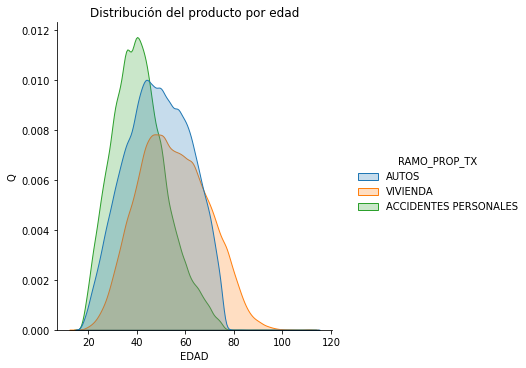

In [ ]:
plt.figure()
ax = sns.displot(data=df, x='EDAD', kind='kde', hue='RAMO_PROP_TX', fill=True)
ax.set(xlabel='EDAD', ylabel='Q', title='Distribución del producto por edad')

In [ ]:
fig = px.box(df, x = 'RAMO_PROP_TX' , y='EDAD' , color ='RAMO_PROP_TX')
fig.show()

En estos gráficos puede observarse que el seguro de Vivienda es el que predomina en las edades más avanzadas de la población y que el pico de contratación tanto en seguro de Accidentes Personales como en Autos está en personas de alrededor de 40 años de edad.

# **Distribución de producto por género**

Mediante esta variable podremos analizar la distribución de clientes que adquieren cierto producto clasificados por género.

Esto permite generar un plan de acción a la hora de distribuir y comunicar los productos conforme a las necesidades e intereses “aproximados” de cada género. Siempre teniendo en cuenta la individualidad y la diversidad de las personas ya que no todos los hombres ni todas las mujeres son iguales. 

Asimismo, esta variable va a permitir demostrar en el futuro los cambios de intereses y hábitos a lo largo del tiempo, producto de las transformaciones sociales y culturales. Por ejemplo: Está demostrado que el número de mujeres que adquieren los servicios de seguros va aumentando año a año.


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



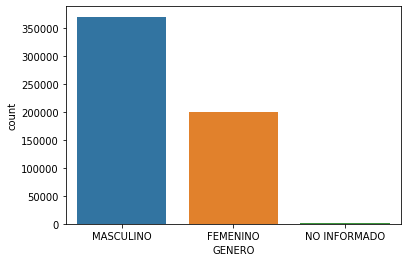

In [ ]:
sns.countplot(df['GENERO'])

Puede observarse que aproximadamente un 65% de las pólizas fueron contratadas por personas de género masculino. Como dato extra, esta misma proporción se mantiene específicamente para los seguros de Autos mientras que en seguros de Vivienda hay menos diferencia por género. Por el contrario, solo el 30% de los certificados de Accidentes Personales fueron contratados por mujeres.

# **Distribución de producto por Medio de Pago**

Por Medio de pago --> Mediante esta variable podremos determinar la distribución por producto del canal y medio de pago elegido al momento de adquirir un seguro determinado, permitiendo así identificar los más utilizados por los consumidores. 

De este modo, la Compañia de Seguros puede buscar la manera de agilizar el cobro mediante esos medios. Por ejemplo: invirtiendo y/o desarrollando  una plataforma para realizar los pagos electrónicos que resulte fácil de utilizar para el posible consumidor.

Esto resulta ser una herramienta útil a la hora de planificar y controlar el volumen de pagos y, de esta forma, garantizar la liquidez de la empresa logrando la:

- Optimización de los tiempos del proceso de venta.
- Optimización del proceso de facturación.
- Reducción y optimización del plazo de cobro. 

Los medios de pago disponible son:

A) A través de cuenta bancaria
B) A través de tarjeta de crédito

Y los canales disponibles para la contratación de los seguros son:

1) Sucursales físicas
2) Contact center
3) Medio Digital (Web)
4) VIP
5) Otros


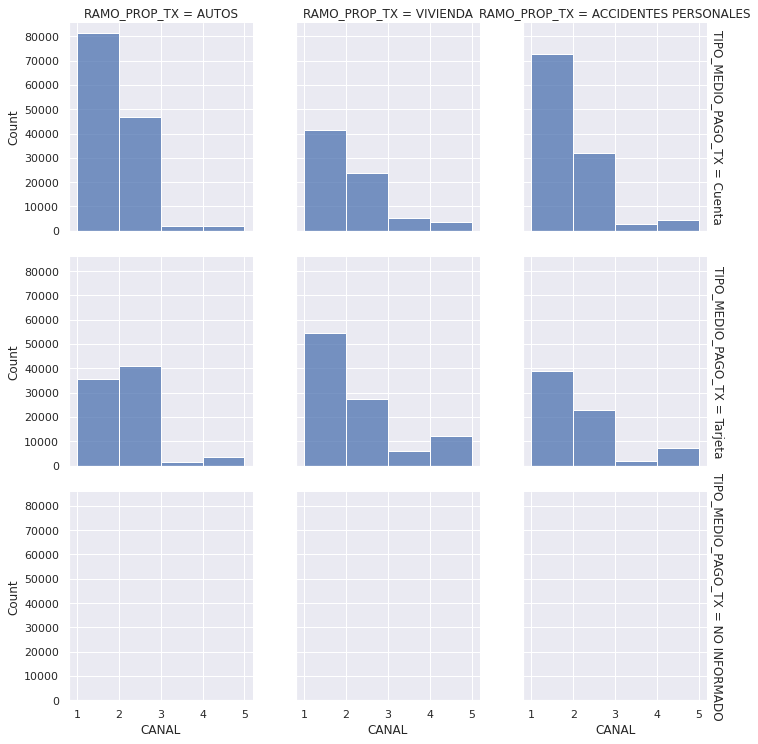

In [ ]:
sns.set_theme(style="darkgrid")

sns.displot(
    df, x="CANAL", col="RAMO_PROP_TX", row="TIPO_MEDIO_PAGO_TX",
    binwidth=1, height=3.5, facet_kws=dict(margin_titles=True),
)

En todos los productos predomina el canal 1 (Sucursales) cuando el medio de pago elegido es a través de la cuenta bancaria. Sin embargo, si el medio adherido es la tarjeta de crédito, los asegurados con producto Auto optan en su mayoría por el canal 2 (Contact Center), pero mantienen la preferencia por el canal 1 (Sucursales) en Vivienda y Accidentes Personales. 
Por otro lado, tanto el canal 2 (Web), el 3 (VIP) como el 4 (Otros) son los menos favoritos a la hora de contratar las pólizas. 
Podemos concluir que, en general, los clientes prefieren que una persona, ya sea presencial o telefónicamente, los asesore y acompañe en el procedimiento de compra de los productos.


# **Distribución de producto por Segmento**

Por Segmento --> Mediante esta variable podremos determinar la distribución de producto por Segmento, siendo 1 el segmento de renta más alto y 9 el mas bajo. 

La compañía de seguros puede realizar acciones comerciales diferenciales para cada segmento y producto. Por ejemplo: darle mayores coberturas a los segmentos de rentas más altas.


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



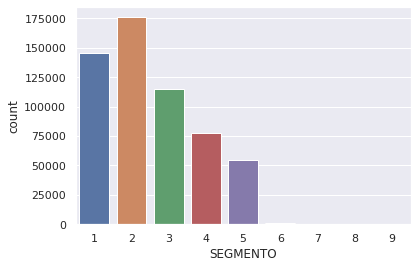

In [ ]:
sns.countplot(df['SEGMENTO'])

El 30% de los contratantes están asociados al segmento nº2, el 25% al segmento nº1 y luego de manera decreciente se distribuye el restante 45% entre los segmentos siguientes. 
Por lo tanto, el foco de la compañía a la hora de ofrecer nuevos productos estará principalmente en los segmentos nº 1, 2 y 3.

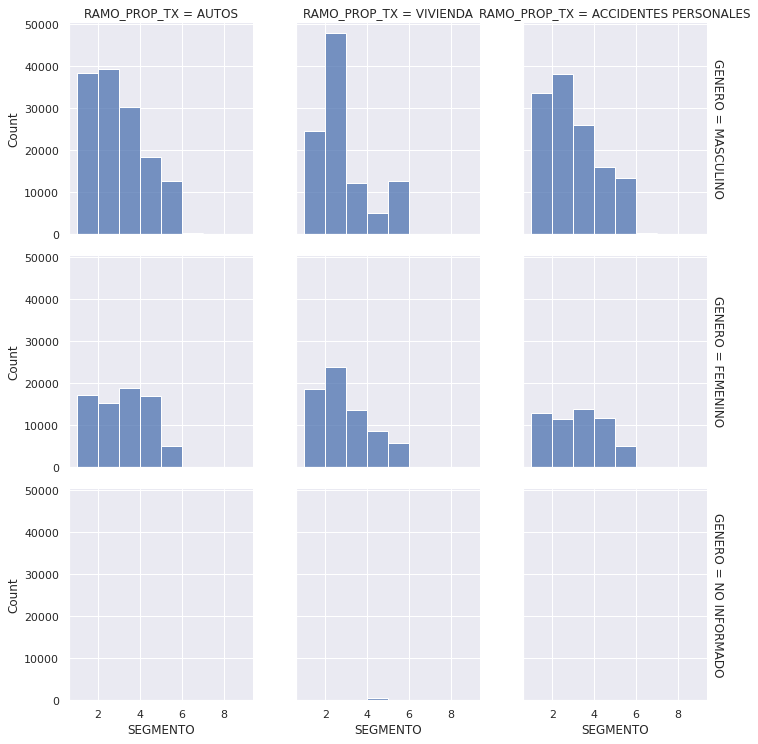

In [ ]:
sns.set_theme(style="darkgrid")

sns.displot(
    df, x="SEGMENTO", col="RAMO_PROP_TX", row="GENERO",
    binwidth=1, height=3.5, facet_kws=dict(margin_titles=True),
)

Mismo análisis podemos hacer clasificando, a su vez, por género del contratante y tipo de producto. 
Según el resultado de este gráfico, observamos que la mayor parte de los hombres están catalogados en segmento entre 2 y 3 en los 3 tipos de seguros mientras que, en las mujeres, la distribución varía un poco; en Autos y Accidentes personales predominan los segmentos 2 y 4 y, en el caso de Vivienda, segmentos entre 2 y 3, coincidiendo con el género masculino.

# **ANALISIS BIVARIADO**

Mediante el análisis de dos variables en nuestro proyecto, buscaremos conocer la relación entre dos conjuntos de datos, como pares de observaciones tomadas de una misma muestra y así determinar la causalidad, efectos o correlaciones entre los mismos.

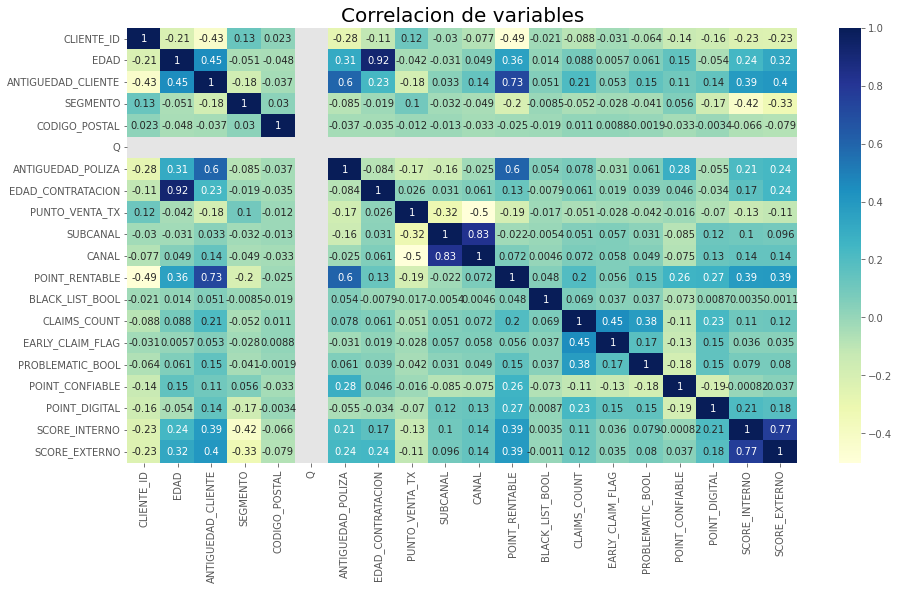

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8)

sns.heatmap(df.corr(), annot = True, cmap = 'YlGnBu')
plt.title('Correlacion de variables', fontsize = 20)
plt.show()

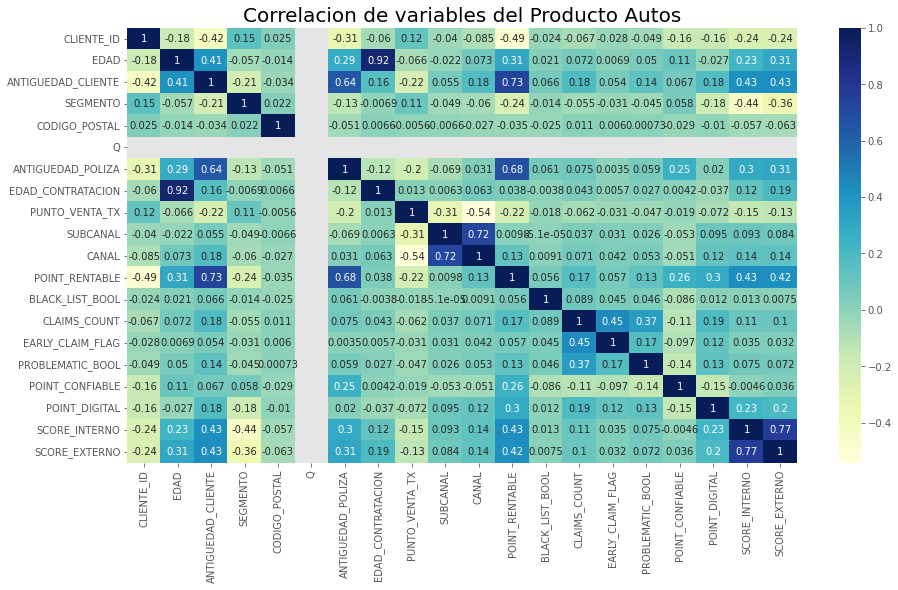

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8)

sns.heatmap(df_prod_a.corr(), annot = True, cmap = 'YlGnBu')
plt.title('Correlacion de variables del Producto Autos', fontsize = 20)
plt.show()

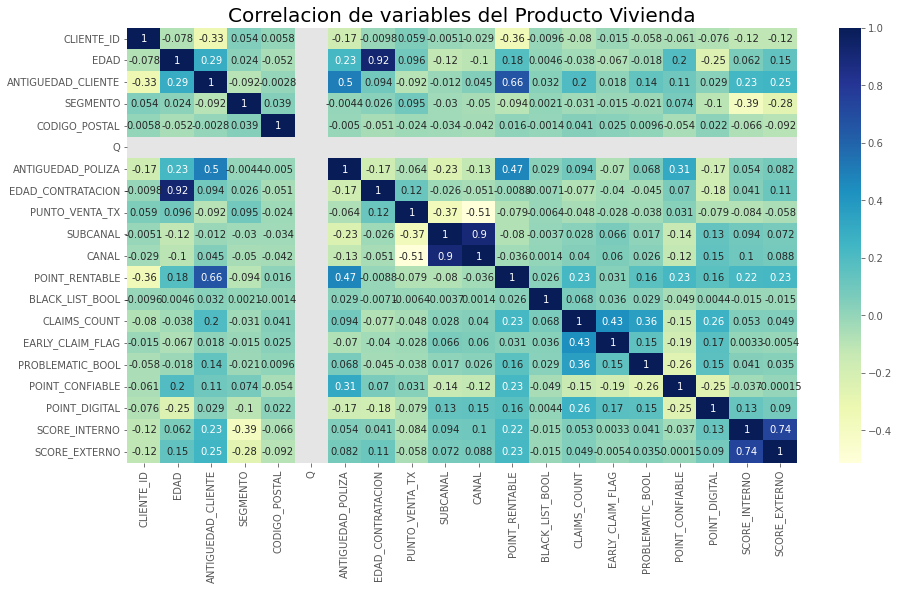

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8)

sns.heatmap(df_prod_b.corr(), annot = True, cmap = 'YlGnBu')
plt.title('Correlacion de variables del Producto Vivienda', fontsize = 20)
plt.show()

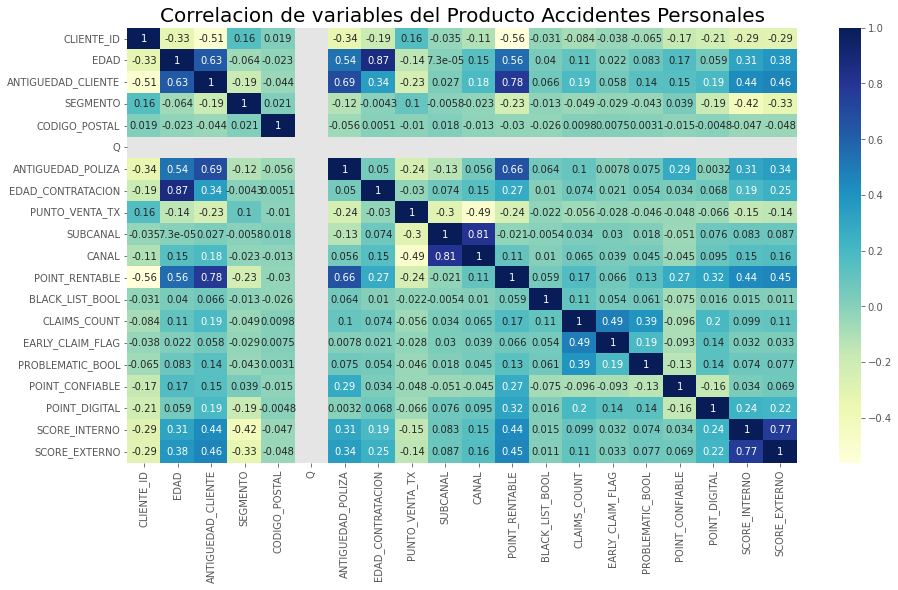

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8)

sns.heatmap(df_prod_c.corr(), annot = True, cmap = 'YlGnBu')
plt.title('Correlacion de variables del Producto Accidentes Personales', fontsize = 20)
plt.show()

Podemos definir 'Correlación' como la medida estadística que expresa hasta qué punto dos variables están relacionadas linealmente, esto es, cambian conjuntamente a una tasa constante. Su coeficiente se identifica con la letra 'r' y su significado varía dependiendo el valor que tome:

1) un valor positivo indica una relación directa o positiva entre ambas variables
2) un valor negativo indica relación indirecta, inversa o negativa entre ambas variables
3) un valor nulo indica que no existe una tendencia entre ambas variables

Para nuestro análisis observamos las correlaciones en conjunto, para la base completa de los 3 productos y, luego, para cada uno de manera independiente.


In [ ]:
fig = px.box(df, x = 'RAMO_PROP_TX' , y='EDAD' ,color='GENERO' ,title="Relacion por producto de la edad y genero")
fig.show()

Para el análisis bivariado entre la edad y el género del contratante, para cada uno de los productos, elegimos el Boxplot.
Si bien los gráficos entre géneros son bastante similares, los resultados muestran que en los 3 tipos de seguros la mediana de la edad de las mujeres es mínimamente superior a la de los hombres. 

In [ ]:
fig = px.box(df, x = 'RAMO_PROP_TX' , y='EDAD' ,color='CANAL' ,title="Relacion por producto de la edad y canal")
fig.show()

El resultado más notorio de este análisis es las edades que abarca el boxplot del canal 4 en color naranja (VIP) que se encuentra bastante por encima que los demás canales. 
Esto significa que, a mayor edad, los contratantes prefieren recurrir a una asistencia más personalizada, como podría ser el soporte que brinda un productor de seguros, actuando como intermediario entre la compañia y el asegurado y facilitándole la logística de variados trámites a este último.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



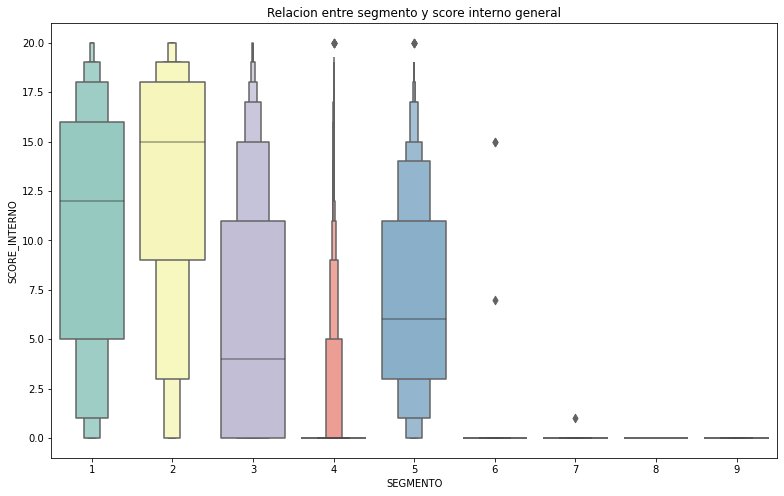

In [ ]:
sns.boxenplot(df['SEGMENTO'], df['SCORE_INTERNO'], palette = 'Set3')
plt.title('Relacion entre segmento y score interno general')
plt.show()

Se observa que los segmentos de renta más altas (1 y 2) tiene Score Interno más alto, esto significa que son menos riesgosos a la cancelación de la póliza.

In [ ]:
sns.boxenplot(df_prod_a['SEGMENTO'], df_prod_a['SCORE_INTERNO'], palette = 'Set3')
plt.title('Relacion entre segmento y score interno del producto Autos')
plt.show()

In [ ]:
sns.boxenplot(df_prod_b['SEGMENTO'], df_prod_b['SCORE_INTERNO'], palette = 'Set3')
plt.title('Relacion entre segmento y score interno del producto Vivienda')
plt.show()

In [ ]:
sns.boxenplot(df_prod_c['SEGMENTO'], df_prod_c['SCORE_INTERNO'], palette = 'Set3')
plt.title('Relacion entre segmento y score interno del producto Accidentes Personales')
plt.show()

In [ ]:
print('Relacion entre el segmento y producto')
pd.crosstab(df.SEGMENTO, df.RAMO_PROP_TX, normalize=True) 

Como observamos en análisis anteriores, se muestra una clara tendencia a haber mayor concentración de asegurados en los segmentos más bajos (1 y 2) que representan las rentas más altas.

Relacion entre la edad de contratacion y el score interno general


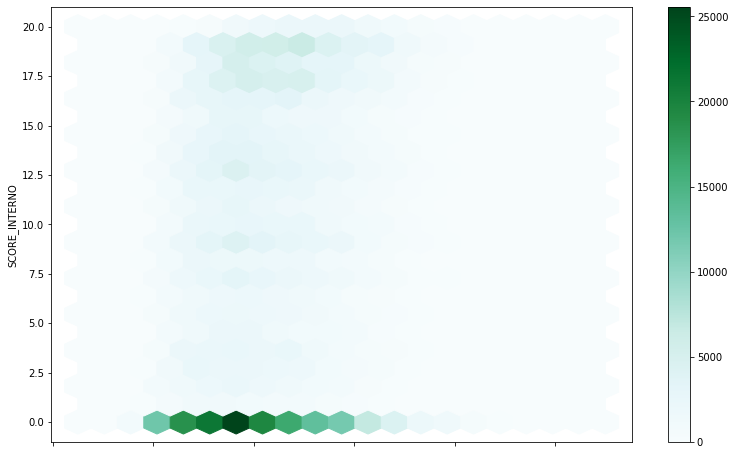

In [ ]:
print('Relacion entre la edad de contratacion y el score interno general')
df.plot.hexbin(x='EDAD_CONTRATACION', y='SCORE_INTERNO', gridsize=20)
plt.show()

Para representar la relación entre la edad del asegurado al momento de la contratación de la póliza y el Score Interno utilizamos el gráfico de dispersional hexagonal, que se utiliza para comparar los valores que toman dos variables distintas, una de las cuales se representa a lo largo del eje x y la otra a lo largo del eje y. El diagrama de dispersión de Hexbin proporciona una forma de visualizar datos utilizando varios contenedores y puntos de datos según la densidad. La gráfica resultante nos permite identificar visualmente la posible correlación entre las dos variables.
En este caso, observamos una correlación prácticamente nula entre edad de contratación y score interno.



In [ ]:
print('Relacion entre la edad de contratacion y el score interno del producto A')
df_prod_a.plot.hexbin(x='EDAD_CONTRATACION', y='SCORE_INTERNO', gridsize=20)
plt.show()

In [ ]:
print('Relacion entre la edad de contratacion y el score interno del producto B')
df_prod_b.plot.hexbin(x='EDAD_CONTRATACION', y='SCORE_INTERNO', gridsize=20)
plt.show()

In [ ]:
print('Relacion entre la edad de contratacion y el score interno del producto C')
df_prod_c.plot.hexbin(x='EDAD_CONTRATACION', y='SCORE_INTERNO', gridsize=20)
plt.show()

# **ANALISIS MULTIVARIADO**


A diferencia de los estudios univariables y bivariables, en los multivariables se plantean más de una variable dependiente y varias independientes, y apelamos a otras herramientas estadísticas llamadas “multivariantes”.

El objetivo del análisis multivariado es variable en relación a lo que queremos conseguir con él. Esto permite  ver la relación entre variables y cuantificar la relación entre ellas, obteniendo una visión general más realista y precisa que cuando se analiza una sola variable.

Para este análisis utilizamos Gráficos en cuadrícula con facet_grid
Esta opción forma una matriz de gráficos por fila y columna por una variable seleccionada., organizando los gráficos en una cuadrícula. 
Permite distribuir en el gráfico tres variables como dimensiones: fila, columna y matiz. 



# **FacetGrid - Relación entre el Canal a través del cual se contrató la póliza y Score Interno vs. Edad de Contratación**

En este ejemplo, la cuadrícula muestra el histograma del ‘SCORE_INTERNO' y la 'EDAD_CONTRATACION' basado en la variable "CANAL". 
“SCORE INTERNO” es la Variable que indica el riesgo previsto por variables interna de la organización. A mayor riesgo, mayor probabilidad de cancelación
El resultado del análisis que muestra el gráfico es que la edad en la que se concretaron más contrataciones varia entre los 40 y 60 años y el score interno es bastante diverso sin importar la edad, siendo el Canal 5 el que generó más contrataciones


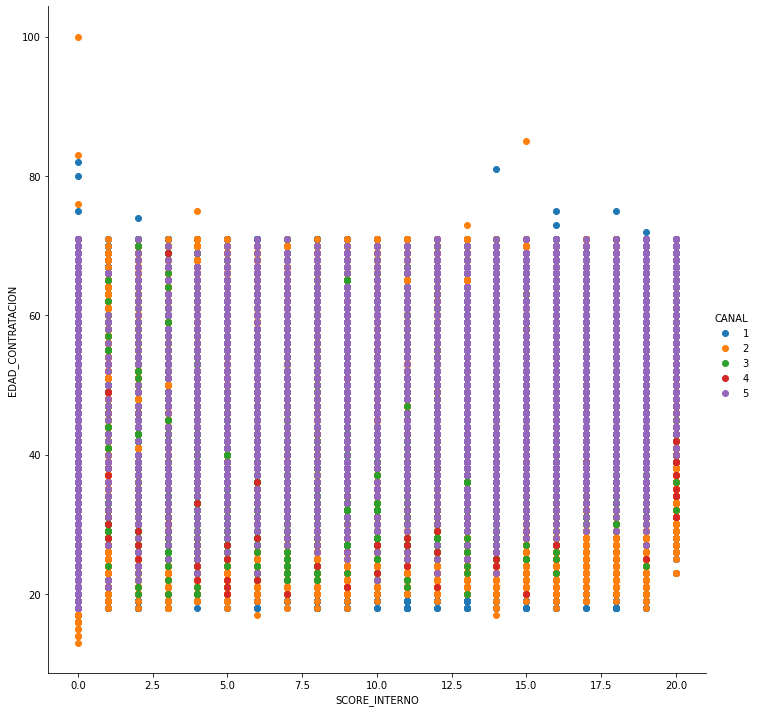

In [ ]:
sns.FacetGrid(df_prod_a,hue = 'CANAL' , height = 10).map(plt.scatter,'SCORE_INTERNO','EDAD_CONTRATACION').add_legend();
plt.show()

# **FacetGrid - Relación entre el género de las personas que contrataron póliza y Score Interno vs. Externo**

En este ejemplo, la cuadrícula muestra el histograma del 'SCORE_INTERNO','SCORE_EXTERNO' basado en la variable "GÉNERO". 
El “Score externo” es la variable que indica el riesgo previsto por variables externas de la organizacion, mientras que el “Score interno” es respecto a variables internas.
El resultado del análisis que muestra el gráfico es que los géneros más visibles a la hora de evaluar los “scores” son el femenino y el “no informado”, siendo un grupo de los “no informados”, los que tienen valores más altos de score.


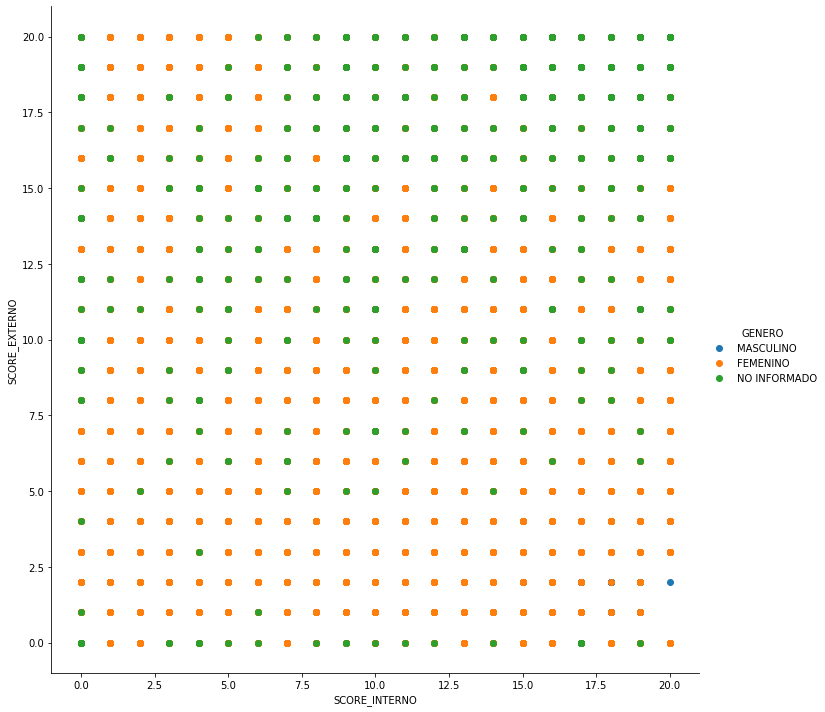

In [ ]:
sns.FacetGrid(df,hue = 'GENERO' , height = 10).map(plt.scatter,'SCORE_INTERNO','SCORE_EXTERNO').add_legend();
plt.show()

# **FacetGrid - Relación entre el género de las personas que contrataron póliza y si el cliente es rentable o no (Score Interno) vs. si el cliente es confiable o no (Score Externo).**

En este ejemplo, la cuadrícula muestra el histograma del 'POINT_RENTABLE' y del 'POINT_CONFIABLE'  basado en la variable "GÉNERO". 
Lo que se muestra es relación entre el género de las personas que contrataron póliza y si el cliente es rentable o no (Score Interno) vs. si el cliente es confiable o no (Score Externo).
El resultado del análisis que muestra el gráfico es que los géneros más visibles a la hora de evaluar los “points” son el femenino y el “no informado”, siendo un grupo de los “no informados”, los que tienen valores más altos de points


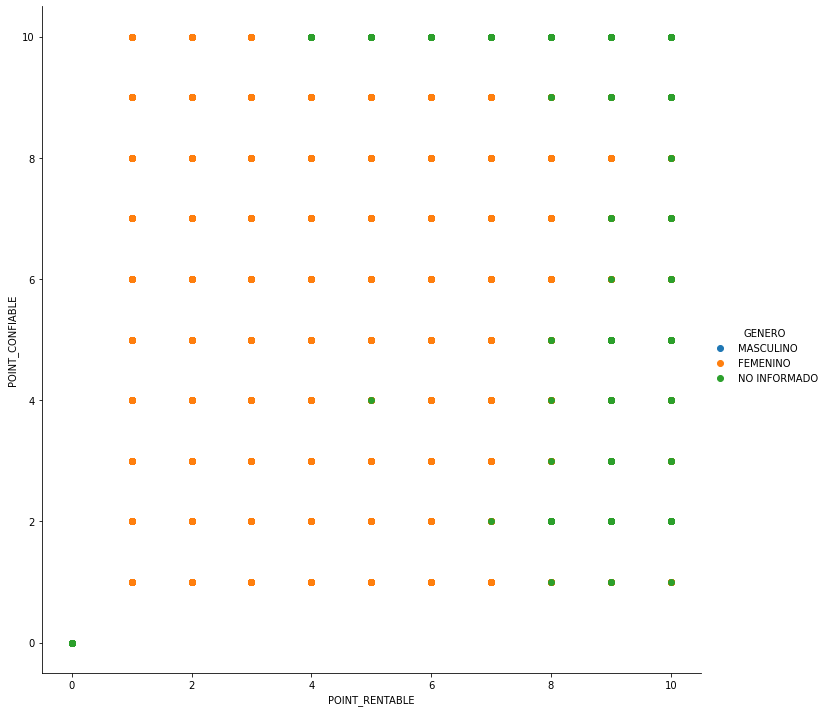

In [ ]:
sns.FacetGrid(df,hue = 'GENERO' , height = 10).map(plt.scatter,'POINT_RENTABLE','POINT_CONFIABLE').add_legend();
plt.show()

Asimismo, realizamos un gráfico PAIRPLOT, el cual correlaciona todas las variables numéricas que hay en el dataset. Esto permite investigar rápidamente la relación cruzada entre todas las variables de un conjunto de datos.



<Figure size 1560x960 with 0 Axes>

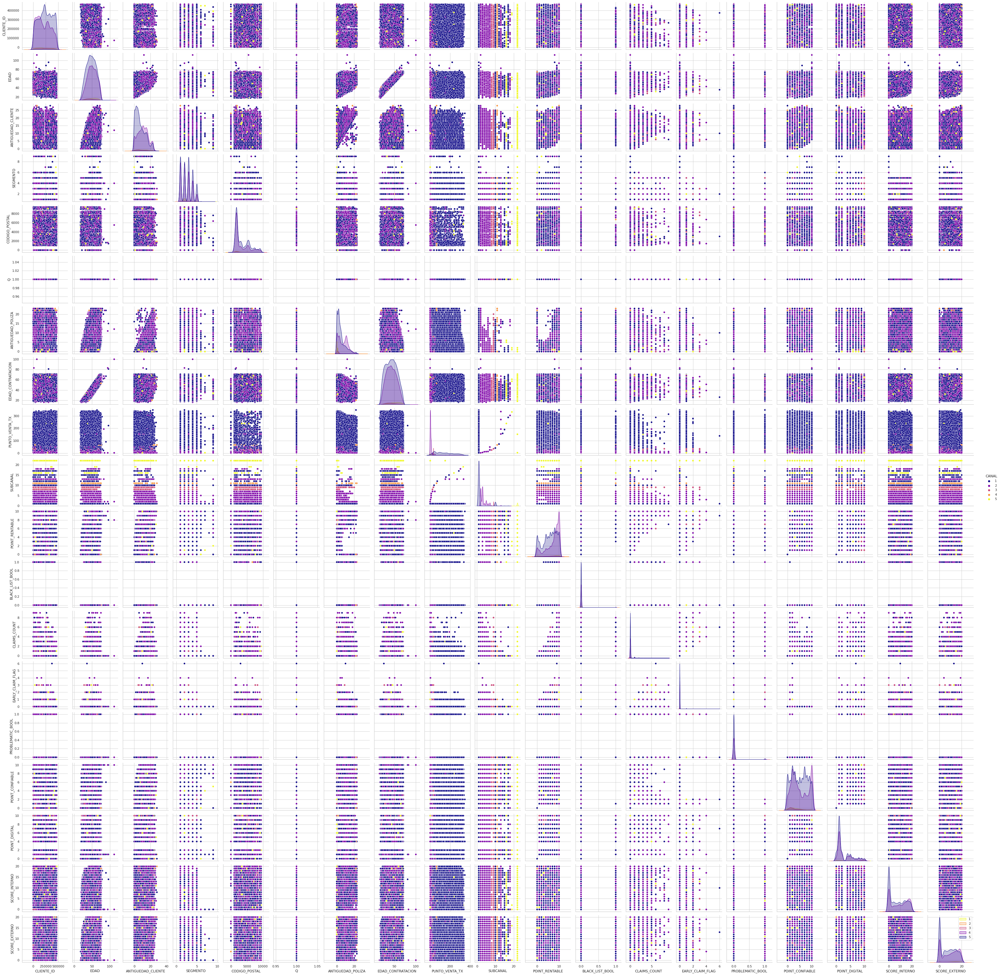

In [ ]:
plt.figure(dpi = 120)
sns.pairplot(df_prod_a,hue = 'CANAL',palette = 'plasma')
plt.legend(['1','2','3','4','5'])
plt.show()

#**PCA: Análisis de componentes principales**

Mediante el análisis de componentes principales se desea definir perfiles de comportamiento de los asegurados, a partir de sus datos, para ofrecer a la compañía aseguradora una forma de seleccionar su cartera de clientes.



In [ ]:
df_pca = df [['EDAD', 'ANTIGUEDAD_CLIENTE',  'SEGMENTO',  'ANTIGUEDAD_POLIZA', 'EDAD_CONTRATACION', 'SUBCANAL', 'CANAL', 'POINT_RENTABLE','POINT_CONFIABLE', 'POINT_DIGITAL' ,'SCORE_INTERNO', 'SCORE_EXTERNO']]
df_pca

,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,SCORE_INTERNO,SCORE_EXTERNO
0,31,5,2,5,26,1,1,7,2,4,6,8
1,56,13,3,13,43,2,2,9,10,1,13,15
2,69,20,2,0,69,22,5,10,4,1,7,10
3,72,2,1,2,70,3,2,6,6,4,17,15
4,55,21,2,11,44,2,2,9,10,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
570374,24,0,4,0,24,7,2,0,0,0,0,0
570375,27,1,4,1,26,1,1,1,5,1,0,0
570376,33,8,3,8,25,10,1,8,2,1,5,6
570377,52,21,3,13,39,1,1,10,4,6,0,0


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

data = df_pca 

scaled_data = StandardScaler().fit_transform(data) 

scaled_data = pd.DataFrame(data=scaled_data, columns=data.columns, index=data.index) 

In [ ]:
#Estadistica basica antes de la estandarizacion de variables
data.describe().round()

,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,SCORE_INTERNO,SCORE_EXTERNO
count,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0
mean,48.0,9.0,3.0,5.0,43.0,4.0,2.0,6.0,5.0,3.0,9.0,9.0
std,14.0,7.0,1.0,5.0,13.0,5.0,1.0,3.0,3.0,3.0,7.0,7.0
min,16.0,0.0,1.0,0.0,5.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
25%,38.0,4.0,1.0,1.0,33.0,1.0,1.0,4.0,2.0,1.0,0.0,1.0
50%,47.0,8.0,2.0,3.0,42.0,1.0,1.0,7.0,4.0,1.0,9.0,10.0
75%,58.0,14.0,3.0,8.0,52.0,3.0,2.0,9.0,7.0,5.0,16.0,15.0
max,112.0,28.0,9.0,23.0,110.0,22.0,5.0,10.0,10.0,10.0,20.0,20.0


In [ ]:
#Estadistica basica luego de la estandarizacion de variables(media=0, desv.est.=1)
scaled_data.describe().round()

,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,SCORE_INTERNO,SCORE_EXTERNO
count,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0,570379.0
mean,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0
std,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
min,-2.0,-1.0,-1.0,-1.0,-3.0,-1.0,-1.0,-2.0,-2.0,-1.0,-1.0,-1.0
25%,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
50%,-0.0,-0.0,-0.0,-0.0,-0.0,-1.0,-1.0,0.0,-0.0,-1.0,0.0,0.0
75%,1.0,1.0,0.0,1.0,1.0,-0.0,0.0,1.0,1.0,1.0,1.0,1.0
max,5.0,3.0,5.0,3.0,5.0,4.0,3.0,1.0,2.0,2.0,2.0,2.0


In [ ]:
n_components = len(scaled_data.columns) 

pca = PCA(n_components=n_components).fit(scaled_data) 
transformed_data = pca.transform(scaled_data) 

columns = [f'PC{i+1}' for i in range(n_components)]

pca_df = pd.DataFrame(data=transformed_data, columns=columns) 
pca_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,-1.240284,-0.050963,-1.743761,-0.467905,0.327691,0.412254,-0.149196,0.023610,-0.438058,-0.419848,0.052434,-3.042450e-16
1,1.798806,-1.117812,-0.140125,1.301593,-1.150142,-0.332537,0.583204,0.400790,-0.012118,-0.039100,-0.388274,1.384923e-16
2,2.330520,3.507959,3.212302,2.152056,-0.045949,0.607036,-1.121238,-1.362223,-0.135532,-0.358490,0.034614,6.517800e-16
3,1.504165,0.373423,1.861075,-1.826213,-0.901590,-0.955979,-0.563572,0.740102,-0.648804,0.122023,-0.379890,1.220874e-16
4,0.829762,-1.621212,0.173534,2.271065,0.053333,-0.031895,-1.642945,-0.541103,0.731547,0.210429,-0.413205,1.432618e-16


In [ ]:
#Concatenacion del dataset sin PCA y con PCA, para poder hacer una correcion de las variables.
df1 = scaled_data.reset_index(drop=True)
df2 = pca_df.reset_index(drop=True)

pca_analysis = pd.concat([df1, df2], axis=1) 
pca_analysis.head()

,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,-1.231078,-0.641963,-0.401628,0.001840,-1.291728,-0.534296,-0.646331,0.174534,-0.865064,0.230317,...,-1.743761,-0.467905,0.327691,0.412254,-0.149196,0.023610,-0.438058,-0.419848,0.052434,-3.042450e-16
1,0.565818,0.549795,0.374860,1.471136,-0.010390,-0.337835,0.380576,0.783739,1.697052,-0.738328,...,-0.140125,1.301593,-1.150142,-0.332537,0.583204,0.400790,-0.012118,-0.039100,-0.388274,1.384923e-16
2,1.500205,1.592584,-0.401628,-0.916471,1.949303,3.591380,3.461296,1.088342,-0.224535,-0.738328,...,3.212302,2.152056,-0.045949,0.607036,-1.121238,-1.362223,-0.135532,-0.358490,0.034614,6.517800e-16
3,1.715832,-1.088872,-1.178116,-0.549147,2.024676,-0.141374,0.380576,-0.130068,0.415994,0.230317,...,1.861075,-1.826213,-0.901590,-0.955979,-0.563572,0.740102,-0.648804,0.122023,-0.379890,1.220874e-16
4,0.493943,1.741553,-0.401628,1.103812,0.064982,-0.337835,0.380576,0.783739,1.697052,-0.738328,...,0.173534,2.271065,0.053333,-0.031895,-1.642945,-0.541103,0.731547,0.210429,-0.413205,1.432618e-16


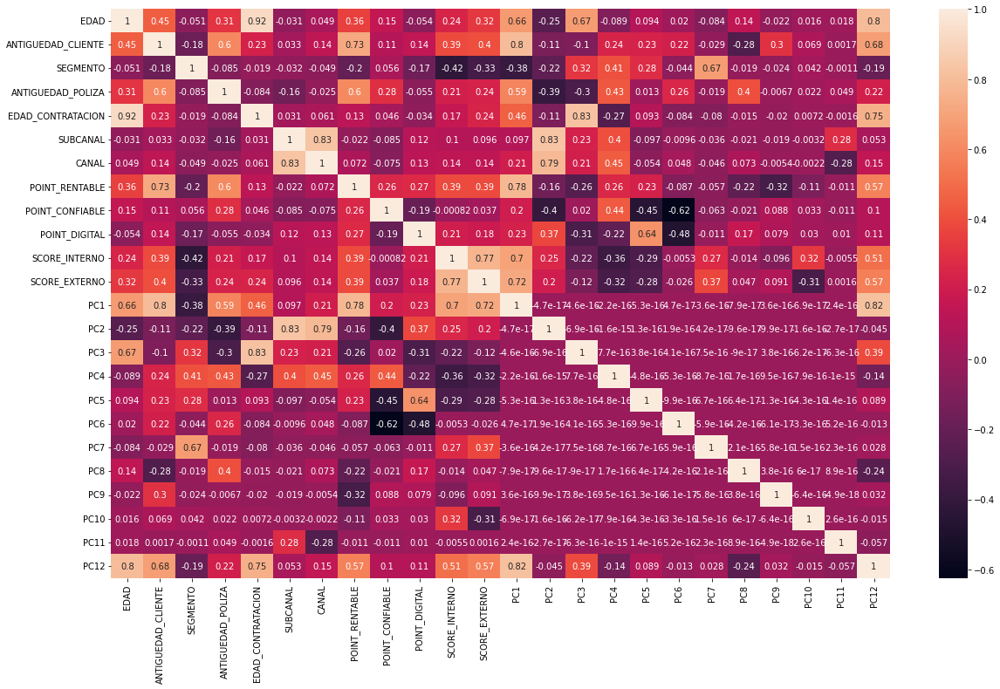

In [ ]:
# Se realiza un análisis de correleaciones para ver qué variables son mejor explicadas por qué componente principal
plt.rcParams['figure.figsize'] = (20, 12)

sns.heatmap(pca_analysis.corr(),annot = True) 

La PC1 está altamente correlacionada a las varaibles: ANTIGUEDAD CLIENTE, POINT RENTABLE, SCORE EXTERNO, SCORE INTERNO.

La PC2 está altamente correlacionada a las varaibles: CANAL, SUBCANAL.

La PC3 está altamente correlacionada a las varaibles: EDAD CONTRATACION.

La PC12 está altamente correlacionada a las varaibles: EDAD, EDAD CONTRATACION Y PC1


PC1 podría ser una nueva variable llamada "SCORES"

PC2 podría ser una nueva variable llamada "CANALES"

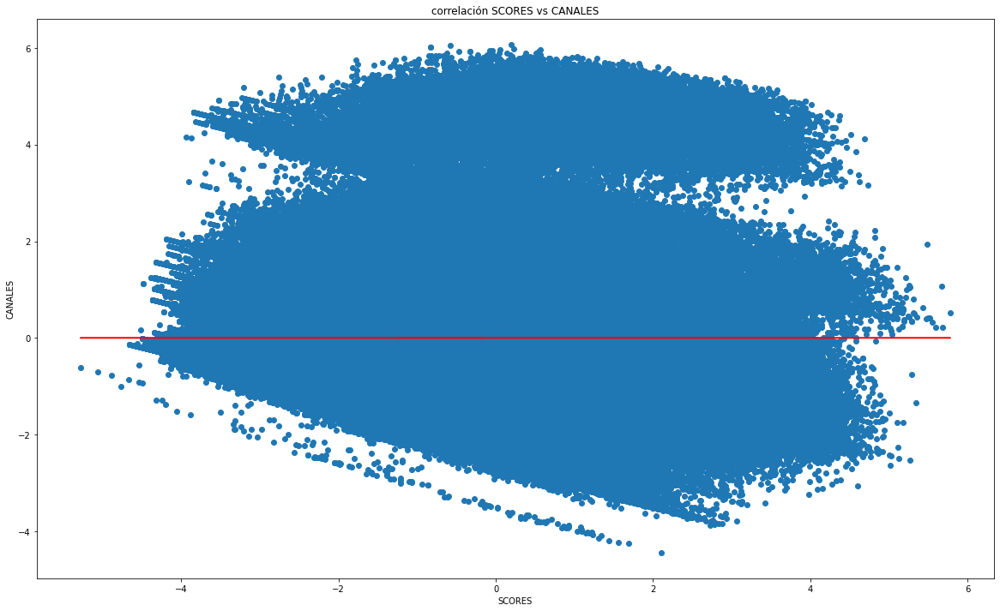

In [ ]:
#Graficamos las componentes principales
x = pca_df.PC1
y = pca_df.PC2

plt.scatter(x,y)

# Obtenemos m (pendiente) y b (intercept0) de la regresión lineal
m, b = np.polyfit(x, y, 1)

# agregamos al regresión al gráfico 
plt.plot(x, m*x+b, 'r-')

plt.xlabel('SCORES')
plt.ylabel('CANALES')
plt.title('correlación SCORES vs CANALES')

plt.show()

No se observa una correlación fuerte entre SCORES y CANALES. Es decir, las variables SCORES no esta determinado por CANALES.

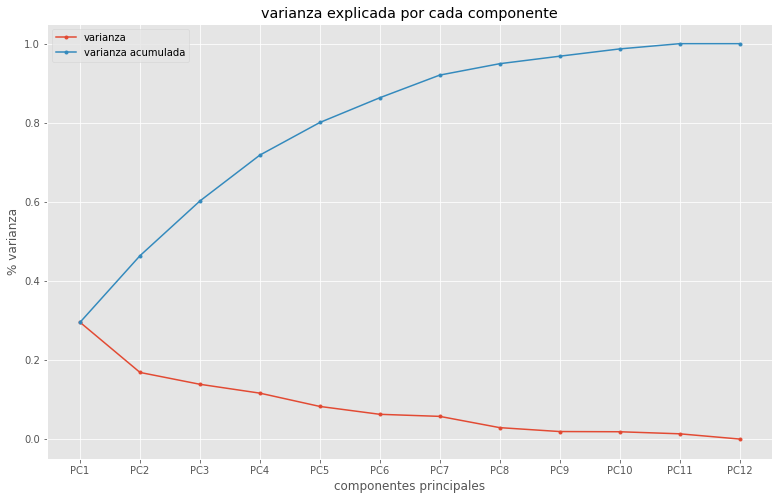

In [ ]:
# Graficamos la varianza individual y acumulada las componentes principales
x = pca_df.columns
y = pca.explained_variance_ratio_
y_cumsum = pca.explained_variance_ratio_.cumsum()
plt.rcParams['figure.figsize'] = (13, 8)
plt.plot(x,y, label='varianza', marker='.')
plt.plot(x,y_cumsum, label='varianza acumulada', marker='.')

plt.xlabel('componentes principales')
plt.ylabel('% varianza')
plt.title('varianza explicada por cada componente')
plt.legend()

plt.show()

Con las primeras cinco componentes explicamos más del 80% de la varianza. Podríamos trabajar sólo con estas cinco variables.

#**Historia de los datos**

La base de datos elegida para realizar el proyecto final está compuesta por un set de personas aseguradas de una compañía internacional de seguros con sede en Argentina. La misma contiene los datos relativos al mes de junio-2022 de 3 productos diferentes que se ofrecen. Se cuenta con un total de 570.379 registros que corresponden a la contratación de un seguro para tres tipos de productos disponibles: Autos, Accidentes Personales y Vivienda.

La rápida digitalización, acelerada por la pandemia, ha cambiado fundamentalmente los objetivos y deseos de los clientes, además de su comportamiento. Es necesario adaptarse e innovar o arriesgarse a perder cuota de mercado a largo plazo.

La transformación digital ha mejorado los métodos tradicionales de recopilación de datos de la industria gracias a las distintas aplicaciones de la tecnología. Permitiendo almacenar la data de manera tal de ser capaz de comprender la evolución de los clientes y automatizar los procesos para de esa manera ofrecer la experiencia más personalizada posible.

Con el dataset propuesto en este Proyecto, vamos a tratar de predecir cuál es el mejor producto que le podemos ofrecer a un nuevo cliente, dadas sus características. Esto permite personalizar al máximo el trato con el cliente y captar su atención para asegurar las ventas. Asimismo, nos permitirá orientar a un cliente a realizar un crosselling de producto.

En conclusión, los resultados de este proyecto permitirán mejorar la eficiencia y la agilidad de los procesos comerciales en toda la compañia,  y de esta forma, aumentar las ventas y la rentabilidad de la misma. 



#**Filtros aplicados a los datos. Distribución. Dataset final para analizar**

Se consideraron 3 subdatasets, para poder analizar las características y la relación de las variables (edades, segmento, score interno, canal, etc.), para cada uno de los productos.


#**Plantear objetivo para esos datos**
El objetivo a alcanzar es predecir cuál es el mejor producto para cada nuevo cliente, dadas sus características.

Esto permite personalizar al máximo el trato con el cliente y captar su atención para asegurar las ventas.

Además, hacer un análisis cross selling entre los clientes existentes para predecir qué otro producto se le puede ofrecer.


# **Árbol de decisión - Producto Autos**


Mediante un Árbol de decisión, vamos a representar gráficamente posibles soluciones a una decisión basadas en ciertas condiciones. Repartiendo las observaciones en función de sus atributos y prediciendo así el valor de la variable respuesta.

Quito las variables que no me interesa que estén en el modelo ya que no son relevantes.

Voy a buscar cuáles son los clientes más rentables para el producto de Autos.
Considero que un cliente es rentable cuando tiene POINT_RENTABLES entre 8 y 10.

In [ ]:
df_prod_a_2 = df_prod_a.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_a_2.POINT_RENTABLE = df_prod_a_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})

In [ ]:
df_prod_a_dummy = pd.get_dummies(df_prod_a_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_a_dummy.shape[0]) + ' filas, y ' + str(df_prod_a_dummy.shape[1]) + ' columnas')
df_prod_a_dummy

Este data set tiene 213097 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
0,31,5,2,5,26,1,1,0,2,4,...,0,0,0,0,0,0,0,1,0,0
1,56,13,3,13,43,2,2,1,10,1,...,0,0,0,1,0,1,0,0,0,0
2,69,20,2,0,69,22,5,1,4,1,...,0,0,0,1,0,0,0,1,0,0
3,72,2,1,2,70,3,2,0,6,4,...,0,0,0,1,0,0,0,1,0,0
4,55,21,2,11,44,2,2,1,10,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213092,43,16,2,16,27,13,2,1,10,6,...,0,0,0,1,0,0,0,0,0,0
213093,63,21,1,15,48,2,2,1,10,5,...,0,0,0,0,0,1,0,0,0,0
213094,51,4,5,4,47,3,2,0,8,1,...,0,0,0,0,0,0,0,1,0,0
213095,41,15,2,0,41,3,2,0,3,5,...,0,0,0,1,0,0,0,1,0,0


In [ ]:
#df_prod_a_dummy.columns.to_list()

In [ ]:
#Separamos en X e y
X = df_prod_a_dummy.drop("POINT_RENTABLE", axis=1) #Elimino de mi dataset la variable a predecir
#print(X.head())
y = df_prod_a_dummy.POINT_RENTABLE #Defino el Target
#print(y.head())

#Importamos la libreria para separar en train y test
from sklearn.model_selection import train_test_split 

#Me quedo con 20% para test y 80% para train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 0) 

from sklearn.tree import DecisionTreeClassifier #Importamos el modelo
tree = DecisionTreeClassifier(max_depth=10,min_samples_split=20,min_samples_leaf=5, random_state = 0) #Creamos el modelo 

#min_samples_split=20 --> cantidad mínima de muestras que debe tener un nodo para poder subdividir.
#min_samples_leaf=5 --> cantidad mínima que puede tener una hoja final. Si tuviera menos, no se formaría esa hoja y “subiría” un nivel, su antecesor.

#Entrenamos el modelo
tree.fit(X_train,y_train)

y_train_pred = tree.predict(X_train) #Prediccion en Train
y_test_pred = tree.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.899916
% de aciertos sobre el set de evaluación: 0.894932
Precision : 0.875594
Recall: 0.902115
F1 Score : 0.888657


[[20272  2539]
 [ 1939 17870]]


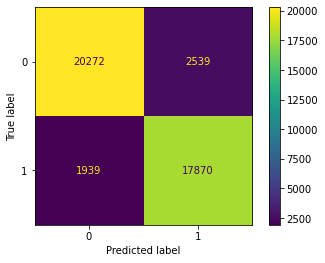

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(tree, X_test, y_test, values_format = 'd')
plt.show()

Mediante una Matriz de Confusión, representamos en una tabla el número de predicciones correctas e incorrectas, para evaluar el rendimiento del modelo. 


AUC for our classifier is: 0.9689121184467423


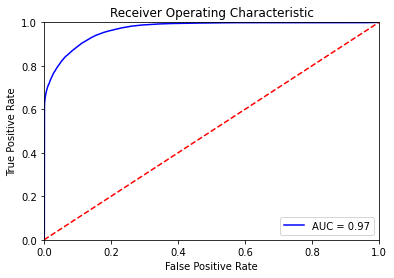

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = tree.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Mediante una Curva Roc,  representamos gráficamente el desempeño del modelo de clasificación en todos los umbrales de clasificación.
Permite comparar diferentes modelos para identificar cual otorga mejor rendimiento como clasificador.




Text(0.5, 1.0, 'Importancia de las características')

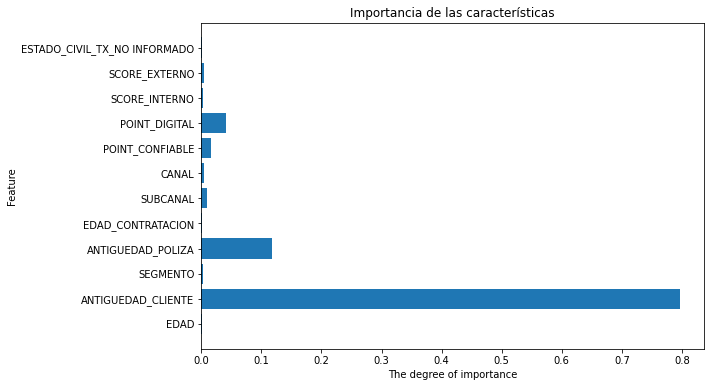

In [ ]:
import seaborn as sns
figsize = plt.subplots(figsize = (9, 6))
importances = tree.feature_importances_> 0.001

# Specifying the contents of the plot
plt.barh(range(sum(importances)), tree.feature_importances_[importances], align = 'center')
plt.yticks(pd.np.arange(sum(importances)), X_train.columns[importances])
plt.xlabel("The degree of importance")
plt.ylabel("Feature")
plt.title('Importancia de las características')

Para mejor visualización de los resultados, se aplicó la condición de tomar solamente las features que tengan un grado de importancia mayor a 0.001. Pero ese valor puede variar si queremos obtener distintas observaciones.

In [ ]:

#feature_importances = pd.DataFrame(tree.feature_importances_,  index=columns)
#feature_importances



# **KNN - Producto Autos**
Mediante un algoritmo KNN buscamos en las observaciones más cercanas a la que se está tratando de predecir y clasificamos el punto de interés basado en la mayoría de datos que le rodean.
Utilizamos la proximidad para hacer clasificaciones o predicciones sobre la agrupación de un punto de datos individual, partiendo de la suposición de que se pueden encontrar puntos similares cerca uno del otro.


In [ ]:
#Es un método que busca en las observaciones más cercanas a la que se está tratando de predecir y clasifica el punto de interés basado 
#en la mayoría de datos que le rodean

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
import seaborn as sb
 
%matplotlib inline
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')
 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [ ]:
df_prod_a_KNN = df_prod_a.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_a_KNN.POINT_RENTABLE = df_prod_a_KNN.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_autos_KNN = pd.get_dummies(df_prod_a_KNN, drop_first=True)

print('Este data set tiene ' + str(df_prod_autos_KNN.shape[0]) + ' filas, y ' + str(df_prod_autos_KNN.shape[1]) + ' columnas')
df_prod_autos_KNN

Este data set tiene 213097 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
0,31,5,2,5,26,1,1,0,2,4,...,0,0,0,0,0,0,0,1,0,0
1,56,13,3,13,43,2,2,1,10,1,...,0,0,0,1,0,1,0,0,0,0
2,69,20,2,0,69,22,5,1,4,1,...,0,0,0,1,0,0,0,1,0,0
3,72,2,1,2,70,3,2,0,6,4,...,0,0,0,1,0,0,0,1,0,0
4,55,21,2,11,44,2,2,1,10,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213092,43,16,2,16,27,13,2,1,10,6,...,0,0,0,1,0,0,0,0,0,0
213093,63,21,1,15,48,2,2,1,10,5,...,0,0,0,0,0,1,0,0,0,0
213094,51,4,5,4,47,3,2,0,8,1,...,0,0,0,0,0,0,0,1,0,0
213095,41,15,2,0,41,3,2,0,3,5,...,0,0,0,1,0,0,0,1,0,0


In [ ]:
#Creamos nuestro X e y de entrada y los sets de entrenamiento y test

X = df_prod_autos_KNN[['EDAD', 'ANTIGUEDAD_CLIENTE',  'SEGMENTO',  'ANTIGUEDAD_POLIZA', 'EDAD_CONTRATACION', 'SUBCANAL', 'CANAL', 'POINT_CONFIABLE', 'POINT_DIGITAL' ,'SCORE_INTERNO', 'SCORE_EXTERNO']].values  
y = df_prod_autos_KNN['POINT_RENTABLE'].values  #Rating rentabilidad del 0 al 10
 
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


Se busca obtener un maximo de 10 grupos. 

Para optimizar el modelo, vamos a buscar cual es k < 11 que tiene mejor accuracy.

([<matplotlib.axis.XTick at 0x7f693533f0d0>,
 <a list of 5 Text major ticklabel objects>)

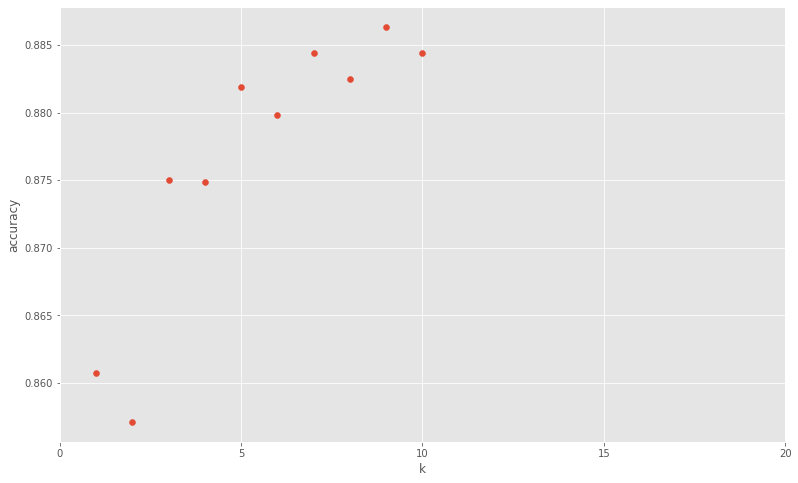

In [ ]:
k_range = range(1,11)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    scores.append(knn.score(X_test, y_test))
plt.figure()
plt.xlabel('k')
plt.ylabel('accuracy')
plt.scatter(k_range, scores)
plt.xticks([0,5,10])

In [ ]:
#Definimos el valor de k en 9 y creamos nuestro clasificador:

n_neighbors = 9
 
knn = KNeighborsClassifier(n_neighbors)
knn.fit(X_train, y_train)
print('Accuracy of K-NN classifier on training set: {:.4f}'
     .format(knn.score(X_train, y_train)))
print('Accuracy of K-NN classifier on test set: {:.4f}'
     .format(knn.score(X_test, y_test)))

Accuracy of K-NN classifier on training set: 0.9075
Accuracy of K-NN classifier on test set: 0.8863


[[25592  2947]
 [ 3108 21628]]


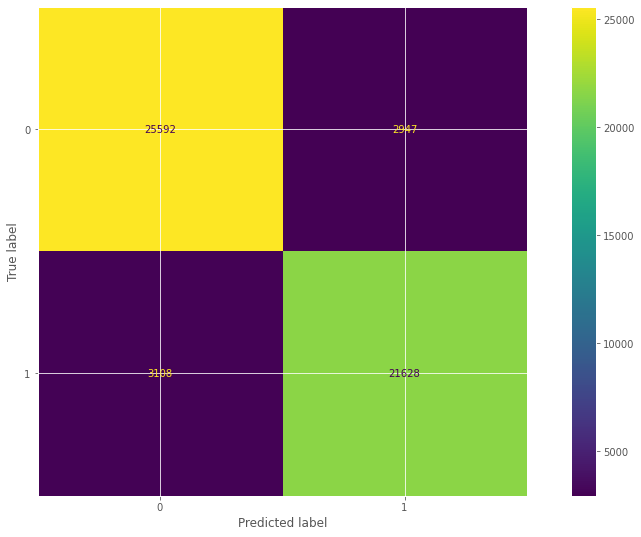

              precision    recall  f1-score   support

           0       0.89      0.90      0.89     28539
           1       0.88      0.87      0.88     24736

    accuracy                           0.89     53275
   macro avg       0.89      0.89      0.89     53275
weighted avg       0.89      0.89      0.89     53275



In [ ]:
#Precisión del modelo --> Confirmemos la precisión viendo la Confusión Matrix y el Reporte sobre el conjunto de test, que nos detalla los aciertos y fallos:

pred = knn.predict(X_test)

#Matriz de Confusión
y_train_pred = knn.predict(X_train) #Prediccion en Train
y_test_pred = knn.predict(X_test) #Prediccion en Test
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(knn, X_test, y_test, values_format = 'd')
plt.show()

#print(classification_report(y_test, pred))

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.907516
% de aciertos sobre el set de evaluación: 0.886344
Precision : 0.880081
Recall: 0.874353
F1 Score : 0.877208


AUC for our classifier is: 0.9579969934698652


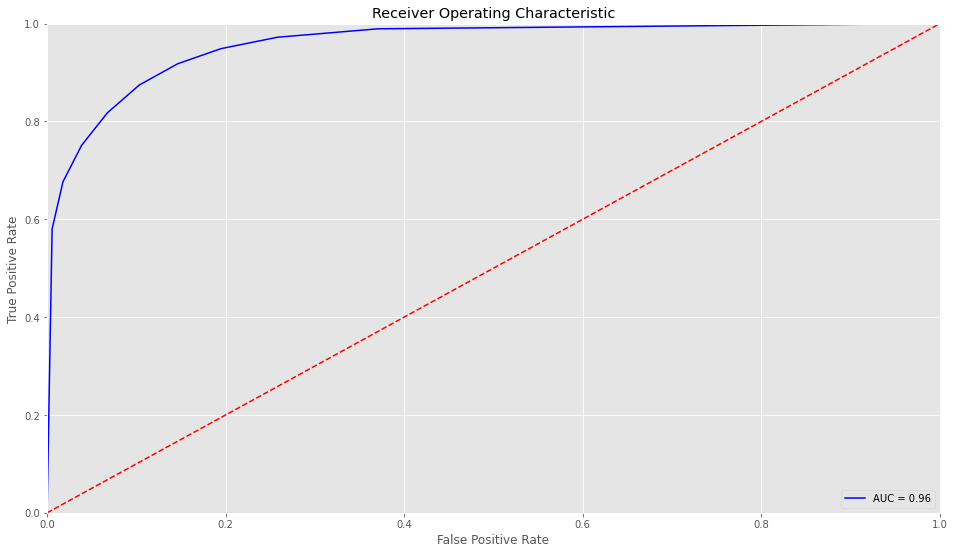

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = knn.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# **Random Forest - Producto Autos**

Mediante un Random Forest, creamos un grupo de modelos predictivos que permiten alcanzar una mejor precisión y estabilidad del modelo. Estos proveen una mejora significativa a los modelos de árboles de decisión. Se combinan todos los resultados de los modelos lo que nos da un resultado final.
De esta forma, al combinar sus resultados, unos errores se compensan con otros y tenemos una predicción que generaliza mejor.


In [ ]:
#Hypertuning utilizando grid search

df_prod_a_2 = df_prod_a.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_a_2.POINT_RENTABLE = df_prod_a_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_a_dummy = pd.get_dummies(df_prod_a_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_a_dummy.shape[0]) + ' filas, y ' + str(df_prod_a_dummy.shape[1]) + ' columnas')
df_prod_a_dummy

Este data set tiene 213097 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
0,31,5,2,5,26,1,1,0,2,4,...,0,0,0,0,0,0,0,1,0,0
1,56,13,3,13,43,2,2,1,10,1,...,0,0,0,1,0,1,0,0,0,0
2,69,20,2,0,69,22,5,1,4,1,...,0,0,0,1,0,0,0,1,0,0
3,72,2,1,2,70,3,2,0,6,4,...,0,0,0,1,0,0,0,1,0,0
4,55,21,2,11,44,2,2,1,10,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213092,43,16,2,16,27,13,2,1,10,6,...,0,0,0,1,0,0,0,0,0,0
213093,63,21,1,15,48,2,2,1,10,5,...,0,0,0,0,0,1,0,0,0,0
213094,51,4,5,4,47,3,2,0,8,1,...,0,0,0,0,0,0,0,1,0,0
213095,41,15,2,0,41,3,2,0,3,5,...,0,0,0,1,0,0,0,1,0,0


In [ ]:
#Separamos los datos de entrada de los de salida
x_data=df_prod_a_dummy.drop('POINT_RENTABLE', axis=1)
y_data=df_prod_a_dummy['POINT_RENTABLE']

#Separamos los datos en train y test
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.2)

#Hypertuning utilizando grid search
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier 

random_forest = RandomForestClassifier() #Instanciamos el modelo

#Definimos los parámetros de búsqueda
params = {
    'n_estimators' : [ 100, 200]
}

grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  # 
                                  cv = 3, 
                                  verbose = 1, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

 #Entrenamos el modelo
grid_random_forest.fit(x_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'n_estimators': [100, 200]},
             scoring='neg_mean_absolute_error', verbose=1)

In [ ]:
grid_random_forest.best_estimator_

RandomForestClassifier(n_estimators=200)

Optimizar los hiperparámetros de un modelo es una tarea crucial para aumentar el rendimiento del algoritmo seleccionado.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
#Separamos en X e y
X = df_prod_a_dummy.drop('POINT_RENTABLE', axis=1)
y = df_prod_a_dummy['POINT_RENTABLE']

#Separamos en train y test!
(X_train, X_test,
y_train, y_test) = train_test_split(X,
                                    y,
                                    stratify=y,
                                    test_size=0.20,
                                    random_state=0)

#Creamos un random forest!
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=15,
                       max_features='sqrt', min_samples_leaf=5,
                       min_samples_split=20, n_estimators=200, random_state=0)

In [ ]:
y_train_pred = model.predict(X_train) #Prediccion en Train
y_test_pred = model.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision: {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score: {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.906445
% de aciertos sobre el set de evaluación: 0.897489
Precision: 0.865254
Recall: 0.922356
F1 Score: 0.892893


[[20040  2836]
 [ 1533 18211]]


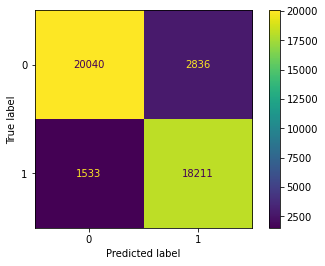

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(model, X_test, y_test, values_format = 'd')
plt.show()

AUC for our classifier is: 0.9718555082871562


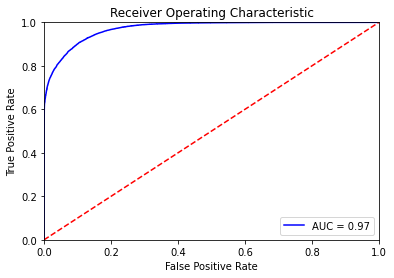

In [ ]:
#Curva ROC
from sklearn.metrics import roc_curve, auc

class_probabilities = model.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Optimización de modelo
Mediante los métodos de optimización que aplicaremos a continuación, podremos ver una descripción general de las mejoras obtenidas y obtener un rendimiento óptimo.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
 
 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
 
kf = KFold(n_splits=5, random_state=0, shuffle=True)
skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
 
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)
 
print("% de aciertos sobre el set de entrenamiento", train_accuracy.round(6))
scores = cross_val_score(model, X_train, y_train, cv=kf, scoring="accuracy")
#print("Accuracy de KFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con KFold", scores.mean().round(6))
scores = cross_val_score(model, X_train, y_train, cv=skf, scoring="accuracy")
#print("Accuracy de StratifiedKFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold", scores.mean().round(6))

preds = model.predict(X_test)
score_pred = metrics.accuracy_score(y_test, preds)
print("% de aciertos sobre el set de evaluación", score_pred.round(6))

% de aciertos sobre el set de entrenamiento 0.906445
Media de % de aciertos sobre el set de entrenamiento con KFold 0.89686
Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold 0.896719
% de aciertos sobre el set de evaluación 0.896246


Se puede observar que los % de aciertos en el set de entrenamiento de KFold y Stratefiel KFold son muy similares entre si.
Tambien, estos ultimos son mas cercanos al % de acierto del set de evaluacion que el modelo de entrenamiento original.

# **Árbol de decisión - Producto Vivienda**


Del mismo modo que para el producto Autos, buscaremos cuáles son los clientes más rentables considerando que un cliente es rentable cuando tiene POINT_RENTABLES entre 8 y 10

In [ ]:
df_prod_b_2 = df_prod_b.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_b_2.POINT_RENTABLE = df_prod_b_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})

In [ ]:
df_prod_b_dummy = pd.get_dummies(df_prod_b_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_b_dummy.shape[0]) + ' filas, y ' + str(df_prod_b_dummy.shape[1]) + ' columnas')
df_prod_b_dummy

Este data set tiene 174291 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
213097,36,13,3,2,34,7,2,0,10,6,...,0,0,0,0,0,0,0,1,0,0
213098,45,7,2,3,42,9,3,1,9,8,...,0,0,0,1,0,0,0,1,0,0
213099,52,5,1,0,52,3,2,0,2,9,...,0,0,0,1,1,0,0,0,0,0
213100,78,11,4,11,67,1,1,1,10,1,...,0,0,0,0,0,0,1,0,0,0
213101,59,18,5,9,50,1,1,1,2,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
387383,44,5,1,5,39,1,1,0,8,9,...,0,0,0,1,0,0,0,0,0,0
387384,41,9,1,0,41,9,3,0,6,1,...,0,0,0,0,0,0,0,1,0,0
387385,74,14,2,1,73,22,5,1,3,1,...,0,0,0,1,1,0,0,0,0,0
387386,65,16,1,16,49,18,2,1,3,1,...,0,0,0,0,0,1,0,0,0,0


In [ ]:
#Separamos en X e y
X = df_prod_b_dummy.drop("POINT_RENTABLE", axis=1) #Elimino de mi dataset la variable a predecir
#print(X.head())
y = df_prod_b_dummy.POINT_RENTABLE #Defino el Target
#print(y.head())

#Importamos la libreria para separar en train y test
from sklearn.model_selection import train_test_split 

#Me quedo con 20% para test y 80% para train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 0) 

from sklearn.tree import DecisionTreeClassifier #Importamos el modelo
tree = DecisionTreeClassifier(max_depth=10,min_samples_split=20,min_samples_leaf=5, random_state = 0) #Creamos el modelo 

#min_samples_split=20 --> cantidad mínima de muestras que debe tener un nodo para poder subdividir.
#min_samples_leaf=5 --> cantidad mínima que puede tener una hoja final. Si tuviera menos, no se formaría esa hoja y “subiría” un nivel, su antecesor.

#Entrenamos el modelo
tree.fit(X_train,y_train)

y_train_pred = tree.predict(X_train) #Prediccion en Train
y_test_pred = tree.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.881476
% de aciertos sobre el set de evaluación: 0.874695
Precision : 0.862309
Recall: 0.927467
F1 Score : 0.893702


[[12129  2932]
 [ 1436 18362]]


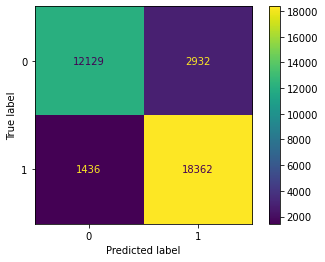

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(tree, X_test, y_test, values_format = 'd')
plt.show()

AUC for our classifier is: 0.9504103908811041


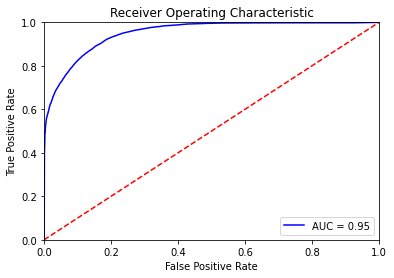

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = tree.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
import seaborn as sns
figsize = plt.subplots(figsize = (9, 6))
importances = tree.feature_importances_> 0.001

# Specifying the contents of the plot
plt.barh(range(sum(importances)), tree.feature_importances_[importances], align = 'center')
plt.yticks(pd.np.arange(sum(importances)), X_train.columns[importances])
plt.xlabel("The degree of importance")
plt.ylabel("Feature")
plt.title('Importancia de las características')

# **KNN - Producto Vivienda**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
import seaborn as sb
 
%matplotlib inline
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')
 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [ ]:
df_prod_b_KNN = df_prod_b.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_b_KNN.POINT_RENTABLE = df_prod_b_KNN.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_vivienda_KNN = pd.get_dummies(df_prod_b_KNN, drop_first=True)

print('Este data set tiene ' + str(df_prod_vivienda_KNN.shape[0]) + ' filas, y ' + str(df_prod_vivienda_KNN.shape[1]) + ' columnas')
df_prod_vivienda_KNN

Este data set tiene 174291 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
213097,36,13,3,2,34,7,2,0,10,6,...,0,0,0,0,0,0,0,1,0,0
213098,45,7,2,3,42,9,3,1,9,8,...,0,0,0,1,0,0,0,1,0,0
213099,52,5,1,0,52,3,2,0,2,9,...,0,0,0,1,1,0,0,0,0,0
213100,78,11,4,11,67,1,1,1,10,1,...,0,0,0,0,0,0,1,0,0,0
213101,59,18,5,9,50,1,1,1,2,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
387383,44,5,1,5,39,1,1,0,8,9,...,0,0,0,1,0,0,0,0,0,0
387384,41,9,1,0,41,9,3,0,6,1,...,0,0,0,0,0,0,0,1,0,0
387385,74,14,2,1,73,22,5,1,3,1,...,0,0,0,1,1,0,0,0,0,0
387386,65,16,1,16,49,18,2,1,3,1,...,0,0,0,0,0,1,0,0,0,0


In [ ]:
#Creamos nuestro X e y de entrada y los sets de entrenamiento y test

X = df_prod_vivienda_KNN[['EDAD', 'ANTIGUEDAD_CLIENTE',  'SEGMENTO',  'ANTIGUEDAD_POLIZA', 'EDAD_CONTRATACION', 'SUBCANAL', 'CANAL', 'POINT_CONFIABLE', 'POINT_DIGITAL' ,'SCORE_INTERNO', 'SCORE_EXTERNO']].values  
y = df_prod_vivienda_KNN['POINT_RENTABLE'].values  #Rating rentabilidad del 0 al 10
 
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


Se busca obtener un maximo de 10 grupos. 

Para optimizar el modelo, vamos a buscar cual es k < 11 que tiene mejor accuracy.

([<matplotlib.axis.XTick at 0x7f69587723d0>,
 <a list of 3 Text major ticklabel objects>)

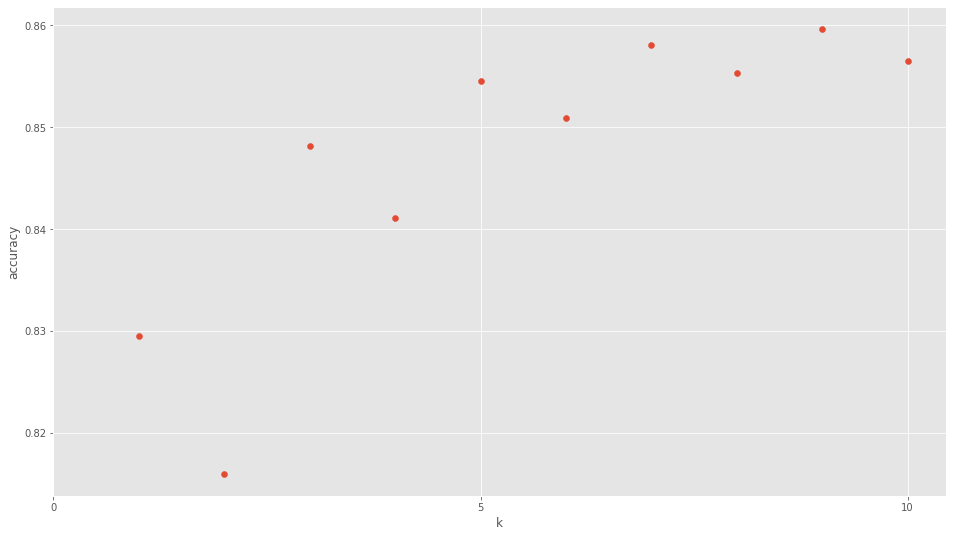

In [ ]:
k_range = range(1,11)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    scores.append(knn.score(X_test, y_test))
plt.figure()
plt.xlabel('k')
plt.ylabel('accuracy')
plt.scatter(k_range, scores)
plt.xticks([0,5,10])

In [ ]:
#Definimos el valor de k en 5 y creamos nuestro clasificador:

n_neighbors = 9
 
knn = KNeighborsClassifier(n_neighbors)
knn.fit(X_train, y_train)
print('Accuracy of K-NN classifier on training set: {:.4f}'
     .format(knn.score(X_train, y_train)))
print('Accuracy of K-NN classifier on test set: {:.4f}'
     .format(knn.score(X_test, y_test)))

Accuracy of K-NN classifier on training set: 0.8861
Accuracy of K-NN classifier on test set: 0.8596


[[15484  3419]
 [ 2697 21973]]


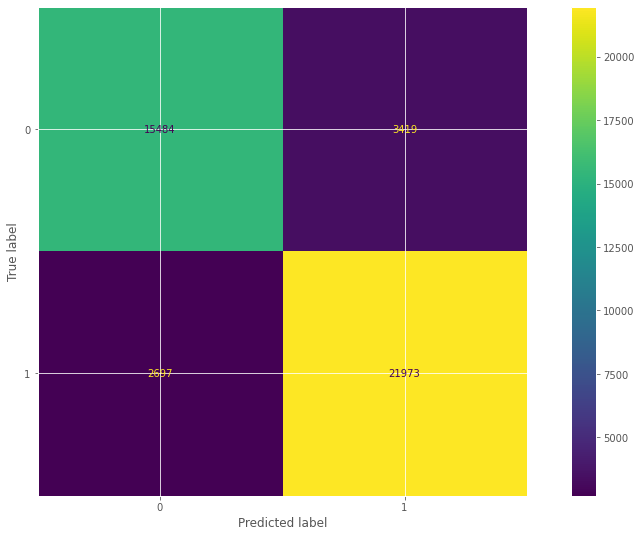

In [ ]:
#Precisión del modelo --> Confirmemos la precisión viendo la Confusión Matrix y el Reporte sobre el conjunto de test, que nos detalla los aciertos y fallos:

pred = knn.predict(X_test)

#Matriz de Confusión
y_train_pred = knn.predict(X_train) #Prediccion en Train
y_test_pred = knn.predict(X_test) #Prediccion en Test
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(knn, X_test, y_test, values_format = 'd')
plt.show()

#print(classification_report(y_test, pred))

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.886114
% de aciertos sobre el set de evaluación: 0.859638
Precision : 0.865351
Recall: 0.890677
F1 Score : 0.877831


AUC for our classifier is: 0.9371236554868334


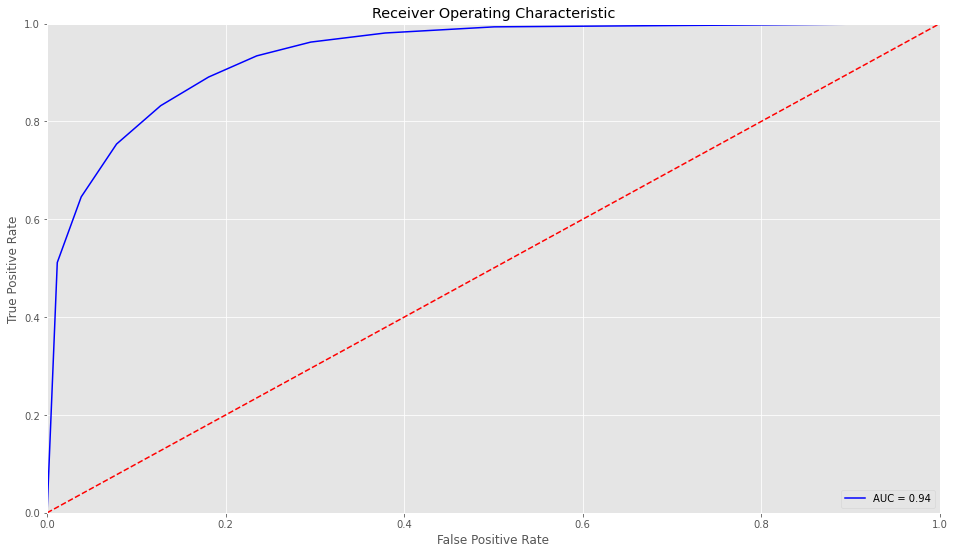

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = knn.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

# **Random Forest - Producto Vivienda**

In [ ]:
#Hypertuning utilizando grid search

df_prod_b_2 = df_prod_b.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_b_2.POINT_RENTABLE = df_prod_b_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_b_dummy = pd.get_dummies(df_prod_b_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_b_dummy.shape[0]) + ' filas, y ' + str(df_prod_b_dummy.shape[1]) + ' columnas')
df_prod_b_dummy

Este data set tiene 174291 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
213097,36,13,3,2,34,7,2,0,10,6,...,0,0,0,0,0,0,0,1,0,0
213098,45,7,2,3,42,9,3,1,9,8,...,0,0,0,1,0,0,0,1,0,0
213099,52,5,1,0,52,3,2,0,2,9,...,0,0,0,1,1,0,0,0,0,0
213100,78,11,4,11,67,1,1,1,10,1,...,0,0,0,0,0,0,1,0,0,0
213101,59,18,5,9,50,1,1,1,2,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
387383,44,5,1,5,39,1,1,0,8,9,...,0,0,0,1,0,0,0,0,0,0
387384,41,9,1,0,41,9,3,0,6,1,...,0,0,0,0,0,0,0,1,0,0
387385,74,14,2,1,73,22,5,1,3,1,...,0,0,0,1,1,0,0,0,0,0
387386,65,16,1,16,49,18,2,1,3,1,...,0,0,0,0,0,1,0,0,0,0


In [ ]:
#Separamos los datos de entrada de los de salida
x_data=df_prod_b_dummy.drop('POINT_RENTABLE', axis=1)
y_data=df_prod_b_dummy['POINT_RENTABLE']

#Separamos los datos en train y test
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.2)

#Hypertuning utilizando grid search
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier 

random_forest = RandomForestClassifier() #Instanciamos el modelo

#Definimos los parámetros de búsqueda
params = {
    'n_estimators' : [ 100, 200]
}

grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  # 
                                  cv = 3, 
                                  verbose = 1, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

 #Entrenamos el modelo
grid_random_forest.fit(x_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'n_estimators': [100, 200]},
             scoring='neg_mean_absolute_error', verbose=1)

In [ ]:
grid_random_forest.best_estimator_

RandomForestClassifier(n_estimators=200)

Optimizar los hiperparámetros de un modelo es una tarea crucial para aumentar el rendimiento del algoritmo seleccionado.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
#Separamos en X e y
X = df_prod_b_dummy.drop('POINT_RENTABLE', axis=1)
y = df_prod_b_dummy['POINT_RENTABLE']

#Separamos en train y test!
(X_train, X_test,
y_train, y_test) = train_test_split(X,
                                    y,
                                    stratify=y,
                                    test_size=0.20,
                                    random_state=0)

#Creamos un random forest!
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=15,
                       max_features='sqrt', min_samples_leaf=5,
                       min_samples_split=20, n_estimators=200, random_state=0)

In [ ]:
y_train_pred = model.predict(X_train) #Prediccion en Train
y_test_pred = model.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision: {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score: {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.888053
% de aciertos sobre el set de evaluación: 0.877162
Precision: 0.873881
Recall: 0.915143
F1 Score: 0.894036


[[12513  2607]
 [ 1675 18064]]


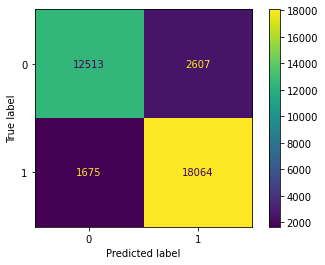

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(model, X_test, y_test, values_format = 'd')
plt.show()

AUC for our classifier is: 0.9541022446096158


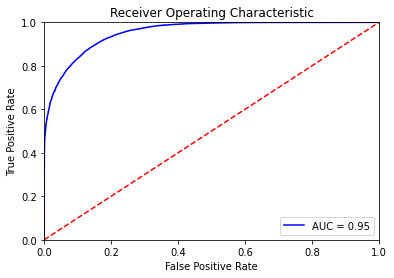

In [ ]:
#Curva ROC
from sklearn.metrics import roc_curve, auc

class_probabilities = model.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Optimización de modelo
Mediante los métodos de optimización que aplicaremos a continuación, podremos ver una descripción general de las mejoras obtenidas y obtener un rendimiento óptimo.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
 
 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
 
kf = KFold(n_splits=5, random_state=0, shuffle=True)
skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
 
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)
 
print("% de aciertos sobre el set de entrenamiento", train_accuracy.round(6))
scores = cross_val_score(model, X_train, y_train, cv=kf, scoring="accuracy")
#print("Accuracy de KFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con KFold", scores.mean().round(6))
scores = cross_val_score(model, X_train, y_train, cv=skf, scoring="accuracy")
#print("Accuracy de StratifiedKFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold", scores.mean().round(6))

preds = model.predict(X_test)
score_pred = metrics.accuracy_score(y_test, preds)
print("% de aciertos sobre el set de evaluación", score_pred.round(6))

% de aciertos sobre el set de entrenamiento 0.888053
Media de % de aciertos sobre el set de entrenamiento con KFold 0.876033
Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold 0.876241
% de aciertos sobre el set de evaluación 0.87613


Se puede observar que los % de aciertos en el set de entrenamiento de KFold y Stratefiel KFold son muy similares entre si.
Tambien, estos ultimos son mas cercanos al % de acierdo del set de evaluacion que el modelo de entrenamiento original.

# **Árbol de decisión - Producto Accidentes Personales**

Del mismo modo que para el producto Autos y Vivienda, buscaremos cuáles son los clientes más rentables considerando que un cliente es rentable cuando tiene POINT_RENTABLES entre 8 y 10

In [ ]:
df_prod_c_2 = df_prod_c.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_c_2.POINT_RENTABLE = df_prod_c_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})

In [ ]:
df_prod_c_dummy = pd.get_dummies(df_prod_c_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_c_dummy.shape[0]) + ' filas, y ' + str(df_prod_c_dummy.shape[1]) + ' columnas')
df_prod_c_dummy

Este data set tiene 182991 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
387388,69,23,2,13,56,2,2,1,4,1,...,0,0,0,0,0,1,0,0,0,0
387389,45,5,3,0,45,3,2,0,1,10,...,0,0,0,0,0,0,0,1,0,0
387390,49,6,4,6,43,4,2,1,9,1,...,0,0,0,0,0,0,0,1,0,0
387391,29,4,1,2,27,7,2,0,1,9,...,0,0,0,1,0,0,0,1,0,0
387392,50,3,2,1,49,1,1,0,7,4,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
570374,24,0,4,0,24,7,2,0,0,0,...,0,0,0,0,0,0,0,1,0,0
570375,27,1,4,1,26,1,1,0,5,1,...,0,0,0,0,0,0,0,1,0,0
570376,33,8,3,8,25,10,1,1,2,1,...,0,0,0,0,0,0,0,1,0,0
570377,52,21,3,13,39,1,1,1,4,6,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
#Separamos en X e y
X = df_prod_c_dummy.drop("POINT_RENTABLE", axis=1) #Elimino de mi dataset la variable a predecir
#print(X.head())
y = df_prod_c_dummy.POINT_RENTABLE #Defino el Target
#print(y.head())

#Importamos la libreria para separar en train y test
from sklearn.model_selection import train_test_split 

#Me quedo con 20% para test y 80% para train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 0) 

from sklearn.tree import DecisionTreeClassifier #Importamos el modelo
tree = DecisionTreeClassifier(max_depth=10,min_samples_split=20,min_samples_leaf=5, random_state = 0) #Creamos el modelo 

#min_samples_split=20 --> cantidad mínima de muestras que debe tener un nodo para poder subdividir.
#min_samples_leaf=5 --> cantidad mínima que puede tener una hoja final. Si tuviera menos, no se formaría esa hoja y “subiría” un nivel, su antecesor.

#Entrenamos el modelo
tree.fit(X_train,y_train)

y_train_pred = tree.predict(X_train) #Prediccion en Train
y_test_pred = tree.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.909592
% de aciertos sobre el set de evaluación: 0.902074
Precision : 0.873863
Recall: 0.913478
F1 Score : 0.893232


[[18023  2164]
 [ 1420 14992]]


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


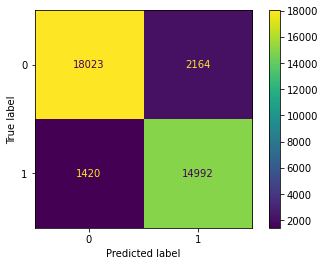

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(tree, X_test, y_test, values_format = 'd')
plt.show()

AUC for our classifier is: 0.9706458375461674


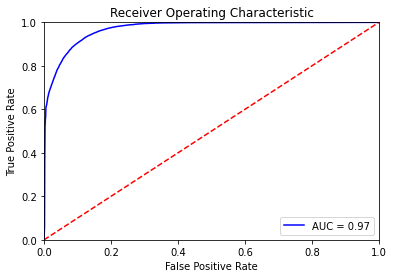

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = tree.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  import sys


Text(0.5, 1.0, 'Importancia de las características')

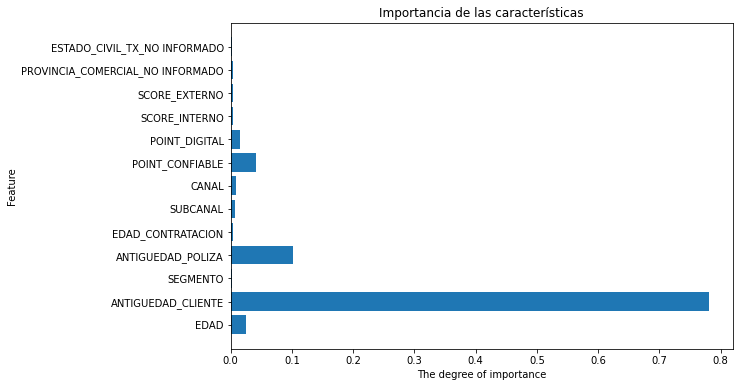

In [ ]:
import seaborn as sns
figsize = plt.subplots(figsize = (9, 6))
importances = tree.feature_importances_> 0.001

# Specifying the contents of the plot
plt.barh(range(sum(importances)), tree.feature_importances_[importances], align = 'center')
plt.yticks(pd.np.arange(sum(importances)), X_train.columns[importances])
plt.xlabel("The degree of importance")
plt.ylabel("Feature")
plt.title('Importancia de las características')

# **Random Forest - Producto Accidentes Personales**

In [ ]:
#Hypertuning utilizando grid search

df_prod_c_2 = df_prod_c.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_c_2.POINT_RENTABLE = df_prod_c_2.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_c_dummy = pd.get_dummies(df_prod_c_2, drop_first=True)

print('Este data set tiene ' + str(df_prod_c_dummy.shape[0]) + ' filas, y ' + str(df_prod_c_dummy.shape[1]) + ' columnas')
df_prod_c_dummy

Este data set tiene 182991 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
387388,69,23,2,13,56,2,2,1,4,1,...,0,0,0,0,0,1,0,0,0,0
387389,45,5,3,0,45,3,2,0,1,10,...,0,0,0,0,0,0,0,1,0,0
387390,49,6,4,6,43,4,2,1,9,1,...,0,0,0,0,0,0,0,1,0,0
387391,29,4,1,2,27,7,2,0,1,9,...,0,0,0,1,0,0,0,1,0,0
387392,50,3,2,1,49,1,1,0,7,4,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
570374,24,0,4,0,24,7,2,0,0,0,...,0,0,0,0,0,0,0,1,0,0
570375,27,1,4,1,26,1,1,0,5,1,...,0,0,0,0,0,0,0,1,0,0
570376,33,8,3,8,25,10,1,1,2,1,...,0,0,0,0,0,0,0,1,0,0
570377,52,21,3,13,39,1,1,1,4,6,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
#Separamos los datos de entrada de los de salida
x_data=df_prod_c_dummy.drop('POINT_RENTABLE', axis=1)
y_data=df_prod_c_dummy['POINT_RENTABLE']

#Separamos los datos en train y test
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.2)

#Hypertuning utilizando grid search
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier 

random_forest = RandomForestClassifier() #Instanciamos el modelo

#Definimos los parámetros de búsqueda
params = {
    'n_estimators' : [ 100, 200]
}

grid_random_forest = GridSearchCV(estimator = random_forest,
                                  param_grid = params,
                                  scoring = 'neg_mean_absolute_error',  # 
                                  cv = 3, 
                                  verbose = 1, #Muestra el resultado en pantalla
                                  n_jobs = -1) # corrida en paralelo

 #Entrenamos el modelo
grid_random_forest.fit(x_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'n_estimators': [100, 200]},
             scoring='neg_mean_absolute_error', verbose=1)

In [ ]:
grid_random_forest.best_estimator_

RandomForestClassifier(n_estimators=200)

Optimizar los hiperparámetros de un modelo es una tarea crucial para aumentar el rendimiento del algoritmo seleccionado.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
#Separamos en X e y
X = df_prod_c_dummy.drop('POINT_RENTABLE', axis=1)
y = df_prod_c_dummy['POINT_RENTABLE']

#Separamos en train y test!
(X_train, X_test,
y_train, y_test) = train_test_split(X,
                                    y,
                                    stratify=y,
                                    test_size=0.20,
                                    random_state=0)

#Creamos un random forest!
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=15,
                       max_features='sqrt', min_samples_leaf=5,
                       min_samples_split=20, n_estimators=200, random_state=0)

In [ ]:
y_train_pred = model.predict(X_train) #Prediccion en Train
y_test_pred = model.predict(X_test) #Prediccion en Test

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision: {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score: {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.916314
% de aciertos sobre el set de evaluación: 0.905052
Precision: 0.862429
Recall: 0.938329
F1 Score: 0.89878


[[17696  2461]
 [ 1014 15428]]


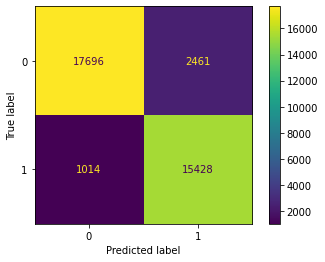

In [ ]:
#Matriz de Confusión
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(model, X_test, y_test, values_format = 'd')
plt.show()

AUC for our classifier is: 0.97420555777398


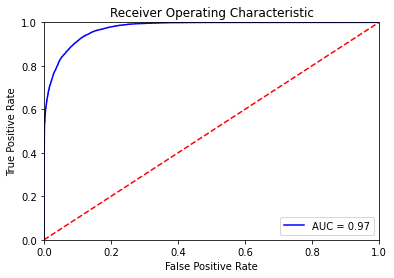

In [ ]:
#Curva ROC
from sklearn.metrics import roc_curve, auc

class_probabilities = model.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Optimización de modelo
Mediante los métodos de optimización que aplicaremos a continuación, podremos ver una descripción general de las mejoras obtenidas y obtener un rendimiento óptimo.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
 
 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
 
kf = KFold(n_splits=5, random_state=0, shuffle=True)
skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
 
model = RandomForestClassifier(max_depth=15,min_samples_split=20,min_samples_leaf=5, random_state = 0, n_estimators=200,
                               class_weight="balanced", max_features="sqrt")
model.fit(X_train, y_train)
 
print("% de aciertos sobre el set de entrenamiento", train_accuracy.round(6))
scores = cross_val_score(model, X_train, y_train, cv=kf, scoring="accuracy")
#print("Accuracy de KFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con KFold", scores.mean().round(6))
scores = cross_val_score(model, X_train, y_train, cv=skf, scoring="accuracy")
#print("Accuracy de StratifiedKFold", scores.round(6))
print("Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold", scores.mean().round(6))

preds = model.predict(X_test)
score_pred = metrics.accuracy_score(y_test, preds)
print("% de aciertos sobre el set de evaluación", score_pred.round(6))

% de aciertos sobre el set de entrenamiento 0.916314
Media de % de aciertos sobre el set de entrenamiento con KFold 0.906054
Media de % de aciertos sobre el set de entrenamiento con StratifiedKFold 0.905862
% de aciertos sobre el set de evaluación 0.903467


Se puede observar que los % de aciertos en el set de entrenamiento de KFold y Stratefiel KFold son muy similares entre si.
Tambien, estos ultimos son mas cercanos al % de acierto del set de evaluacion que el modelo de entrenamiento original.

# **KNN - Producto Accidentes Personales**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
import seaborn as sb
 
%matplotlib inline
plt.rcParams['figure.figsize'] = (16, 9)
plt.style.use('ggplot')
 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [ ]:
df_prod_c_KNN = df_prod_c.drop(['CLIENTE_ID','ACTIVIDAD_ECONOMICA_TX','CODIGO_POSTAL','LOCALIDAD_TX','PUNTO_VENTA_TX','BLACK_LIST_BOOL','CLAIMS_COUNT','EARLY_CLAIM_FLAG','PROBLEMATIC_BOOL','Q'],axis = 1)
df_prod_c_KNN.POINT_RENTABLE = df_prod_c_KNN.POINT_RENTABLE.replace({1 : 0 , 2 : 0, 3 : 0, 4 : 0, 5 : 0, 6 : 0, 7 : 0, 8 : 1, 9 : 1, 10 : 1})
df_prod_accpersonales_KNN = pd.get_dummies(df_prod_c_KNN, drop_first=True)

print('Este data set tiene ' + str(df_prod_accpersonales_KNN.shape[0]) + ' filas, y ' + str(df_prod_accpersonales_KNN.shape[1]) + ' columnas')
df_prod_accpersonales_KNN

Este data set tiene 182991 filas, y 54 columnas


,EDAD,ANTIGUEDAD_CLIENTE,SEGMENTO,ANTIGUEDAD_POLIZA,EDAD_CONTRATACION,SUBCANAL,CANAL,POINT_RENTABLE,POINT_CONFIABLE,POINT_DIGITAL,...,TIPO_VIVIENDA_PISO H/2,TIPO_VIVIENDA_PISO Y DPTO,TIPO_MEDIO_PAGO_TX_NO INFORMADO,TIPO_MEDIO_PAGO_TX_Tarjeta,ESTADO_CIVIL_TX_DIVORCIADO,ESTADO_CIVIL_TX_NO INFORMADO,ESTADO_CIVIL_TX_S / ESPECIF,ESTADO_CIVIL_TX_SOLTERO,ESTADO_CIVIL_TX_UNION CONV,ESTADO_CIVIL_TX_VIUDO
387388,69,23,2,13,56,2,2,1,4,1,...,0,0,0,0,0,1,0,0,0,0
387389,45,5,3,0,45,3,2,0,1,10,...,0,0,0,0,0,0,0,1,0,0
387390,49,6,4,6,43,4,2,1,9,1,...,0,0,0,0,0,0,0,1,0,0
387391,29,4,1,2,27,7,2,0,1,9,...,0,0,0,1,0,0,0,1,0,0
387392,50,3,2,1,49,1,1,0,7,4,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
570374,24,0,4,0,24,7,2,0,0,0,...,0,0,0,0,0,0,0,1,0,0
570375,27,1,4,1,26,1,1,0,5,1,...,0,0,0,0,0,0,0,1,0,0
570376,33,8,3,8,25,10,1,1,2,1,...,0,0,0,0,0,0,0,1,0,0
570377,52,21,3,13,39,1,1,1,4,6,...,0,0,0,0,0,0,0,1,0,0


In [ ]:
#Creamos nuestro X e y de entrada y los sets de entrenamiento y test

X = df_prod_accpersonales_KNN[['EDAD', 'ANTIGUEDAD_CLIENTE',  'SEGMENTO',  'ANTIGUEDAD_POLIZA', 'EDAD_CONTRATACION', 'SUBCANAL', 'CANAL', 'POINT_CONFIABLE', 'POINT_DIGITAL' ,'SCORE_INTERNO', 'SCORE_EXTERNO']].values  
y = df_prod_accpersonales_KNN['POINT_RENTABLE'].values  #Rating rentabilidad del 0 al 10
 
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


Se busca obtener un maximo de 10 grupos. 

Para optimizar el modelo, vamos a buscar cual es k < 11 que tiene mejor accuracy.

([<matplotlib.axis.XTick at 0x7f6929f07450>,
 <a list of 3 Text major ticklabel objects>)

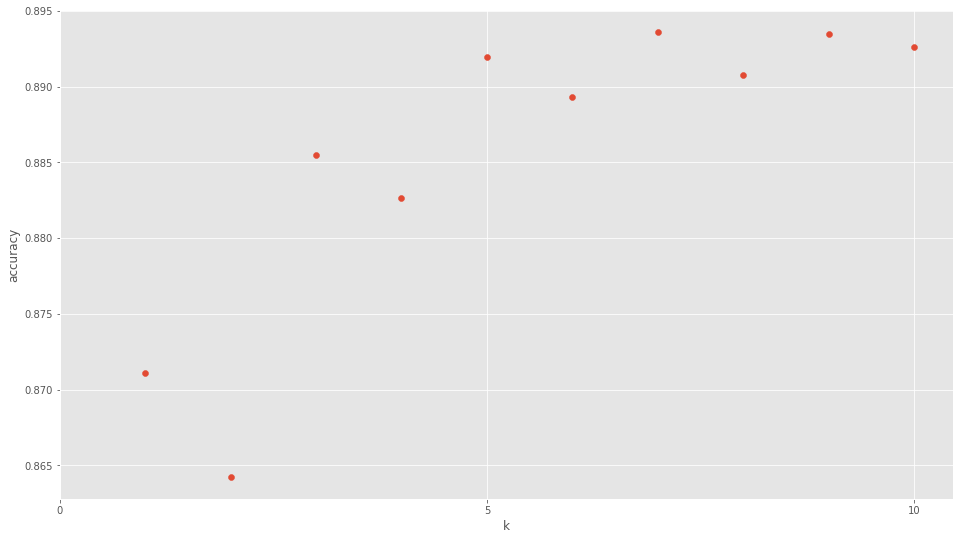

In [ ]:
k_range = range(1,11)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    scores.append(knn.score(X_test, y_test))
plt.figure()
plt.xlabel('k')
plt.ylabel('accuracy')
plt.scatter(k_range, scores)
plt.xticks([0,5,10])

In [ ]:
#Definimos el valor de k en 5 y creamos nuestro clasificador:

n_neighbors = 7
 
knn = KNeighborsClassifier(n_neighbors)
knn.fit(X_train, y_train)
print('Accuracy of K-NN classifier on training set: {:.4f}'
     .format(knn.score(X_train, y_train)))
print('Accuracy of K-NN classifier on test set: {:.4f}'
     .format(knn.score(X_test, y_test)))

Accuracy of K-NN classifier on training set: 0.9194
Accuracy of K-NN classifier on test set: 0.8936


[[22751  2437]
 [ 2430 18130]]


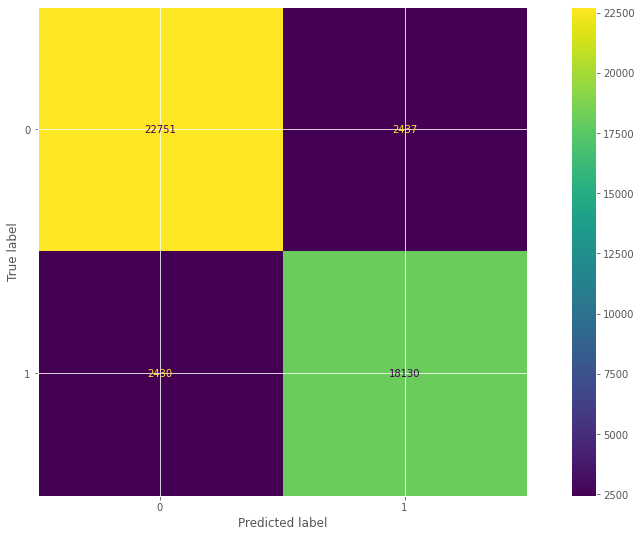

In [ ]:
#Precisión del modelo --> Confirmemos la precisión viendo la Confusión Matrix y el Reporte sobre el conjunto de test, que nos detalla los aciertos y fallos:

pred = knn.predict(X_test)

#Matriz de Confusión
y_train_pred = knn.predict(X_train) #Prediccion en Train
y_test_pred = knn.predict(X_test) #Prediccion en Test
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

#Matriz de Confusión
print(confusion_matrix(y_test, y_test_pred))

#Ploteamos la Matriz
plot_confusion_matrix(knn, X_test, y_test, values_format = 'd')
plt.show()

#print(classification_report(y_test, pred))

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

#Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

#Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy.round(6))
print('% de aciertos sobre el set de evaluación:',test_accuracy.round(6))

# Precision!
print(f"Precision : {precision_score(y_test, y_test_pred).round(6)}")

# Recall
print(f"Recall: {recall_score(y_test, y_test_pred).round(6)}")

# Calculo del F1 score
print(f"F1 Score : {f1_score(y_test, y_test_pred).round(6)}")

% de aciertos sobre el set de entrenamiento: 0.919449
% de aciertos sobre el set de evaluación: 0.893613
Precision : 0.881509
Recall: 0.881809
F1 Score : 0.881659


AUC for our classifier is: 0.9587893293406348


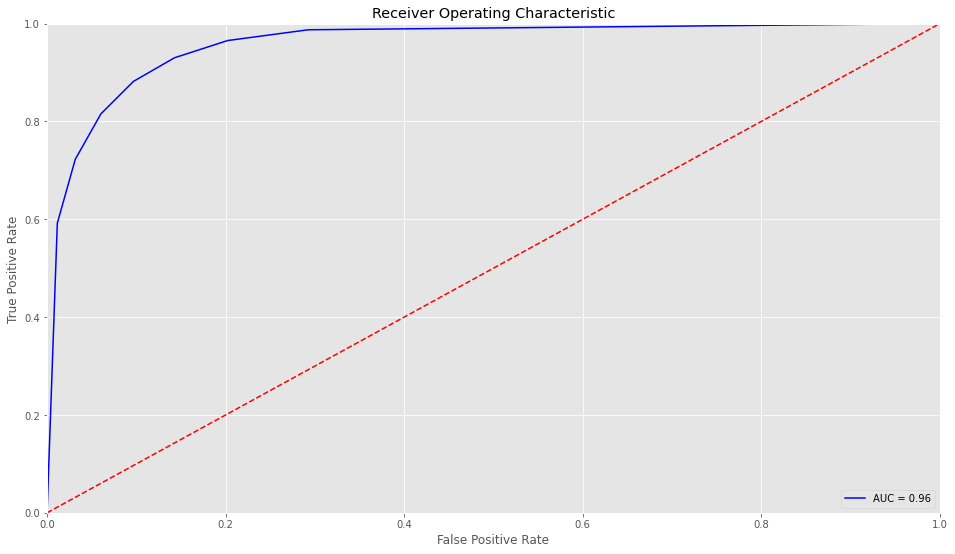

In [ ]:
#Curva ROC (Receiver Operating Characteristic)
# ilustra la sensibilidad y especificidad de cada uno de los posibles puntos de corte de un test diagnóstico cuya escala de medición es continua

from sklearn.metrics import roc_curve, auc

class_probabilities = knn.predict_proba(X_test)
preds = class_probabilities[:, 1]

fpr, tpr, threshold = roc_curve(y_test, preds)
roc_auc = auc(fpr, tpr)

# AUC
print(f"AUC for our classifier is: {roc_auc}")

# Gráfica de la Curva ROC
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

### **Comparativo de Modelos**

Optimizamos el modelo KNN para descubrir qué ‘K’ nos arroja mejores resultados y en base a eso hacer la comparativa:

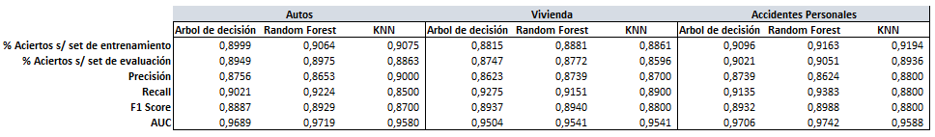
Observamos que a pesar de optimizar el modelo, los niveles de cada métrica siguen siendo más bajos en su mayoría, respecto a los otros dos, por lo tanto decidimos descartarlo.
El modelo Random Forest demostró levemente mejores resultados en casi todas las métricas para los tres productos, salvo en la precisión. Esta menor precisión se asocia con mayor cantidad de falsos positivos - error de tipo I.


## **Optimización del Modelo Random Forest**

Realizamos el Hypertuning utilizando Grid Search para optimizar el parámetro de números de árboles incluido en el modelo (n_estimators).
Para continuar optimizando el modelo se utilizó el método K-Fold Cross-Validation, dividiendo el conjunto en datos en 5 (n_splits=5):
Iteramos 5 veces:
Apartaremos 1/5 de muestras.
Entrenamos al modelo con el restante 4/5 de muestras.
Mediremos el accuracy obtenido la ⅕ apartada.
Esto quiere decir que hacemos 5 entrenamientos independientes. El Accuracy final será el promedio de las 5 accuracies anteriores.

También aplicamos el método de Stratified K-Fold Cross-Validation, que se diferencia del anterior ya que la división del conjunto de datos tiene en cuenta mantener equilibradas las clases.
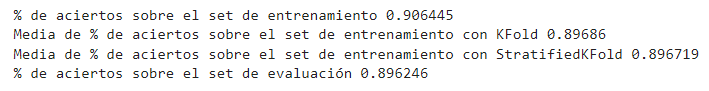

Se puede observar que K-Fold y Stratified K-Fold tienen % de aciertos muy similares entre sí.
Además, son más cercanos al % de aciertos del set de evaluación, que lo que es el modelo original. 
Stratified K-Fold es el más cercano al set de evaluación.